In [1]:
# %pip install gdown

In [2]:
# %pip list

In [3]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import DataLoader, Dataset

import numpy as np
from tqdm.notebook import tqdm
from dataclasses import dataclass

import safetensors
import pathlib
import os 
import matplotlib.pyplot as plt


libgomp: Invalid value for environment variable OMP_NUM_THREADS


In [4]:
device = 'cuda:0'

@dataclass
class config:
    # training params
    is_train_run = True
    n_epochs = 50
    # image params
    image_size = 256
    # dataset params
    batch_size = 2**13 # 64
    dl_num_workers=8
    dl_pin_memory=True,
    # model params
    dict_dim_scaler = 10
    coef_sparse = 1e-2
    # optim params
    lr = 1e-3
    weight_decay = 1e-4
    n_gradient_accumulation_steps = 1
    max_grad_norm = 1.0
    # logging
    log_every_n_grad_steps = 64
    tqdm_print_every_n_grad_steps = 64*4

In [5]:
# import time
# time.sleep(60 * 10)

# Load data

In [6]:
os.listdir()

['diffusion-dict-learn',
 'data',
 '.ipynb_checkpoints',
 'lsun',
 'train-sae.ipynb',
 'sae_checkpoints',
 'train-sae-Copy1.ipynb',
 'train-sae-Copy2-bigbigbatch.ipynb',
 'train-sae-Copy2-bigbatch.ipynb',
 'train-sae-Copy2-10scale+big3batch+moreEp.ipynb',
 'train-sae-Copy2-smallerscale+bigbatch.ipynb',
 'train-sae-Copy2-smallerscale+big5batch+moreEp.ipynb',
 'train-sae-Copy2-smallerscale+bigbigbigbatch.ipynb',
 'train-sae-Copy2-smallerscale+bigbigbigbigbatch+moreEp.ipynb',
 'train-sae-BEST-10scale+big3batch+moreEp.ipynb',
 'train-sae-BEST-10scale+big3batch+moreEp+t150.ipynb',
 'train-sae-BEST-40scale+big3batch+moreEp-Copy1.ipynb',
 'train-sae-BEST-40scale+big3batch+moreEp+t150.ipynb']

In [7]:
# # # Do not use LSUN original
# # Unzip LSUN
# import shutil 
# shutil.unpack_archive(filename='data/lsun/bedroom_train_lmdb.zip', extract_dir='data/lsun', format='zip')

In [8]:
# from datasets import load_dataset

# ds = load_dataset("pcuenq/lsun-bedrooms")
# ds.keys()

In [9]:
# ds

In [10]:
# The script below did not print anything, thus the images are at least 256 in 1 dim
# for img_iter in tqdm(ds['train']):
#     size_img = img_iter['image'].size
    
#     if min(size_img) < 256:
#         print('Smaller than 256')

In [11]:
# # convert to png images

# import torchvision.transforms as T

# # transforms_save = None
# transforms_save = T.CenterCrop(size=config.image_size)

# n_max_images_to_save = 20_000
    
# for subset_str in ['train', 'test']:
#     dir_bigger_ds = pathlib.Path(f'data/bedroom_nolabels/{subset_str}')
#     dir_bigger_ds.mkdir(exist_ok=True)

#     for i, img_iter in tqdm(enumerate(ds[subset_str]), total=len(ds[subset_str])):
#         img_iter = img_iter['image']
#         if transforms_save is not None:
#             img_iter = transforms_save(img_iter)
#         filename_save = f"bedroom_unsup_{i:05d}.png"
#         img_iter.save(dir_bigger_ds / filename_save)
        
#         if i > n_max_images_to_save:
#             break
#         # plt.imshow(img_iter)
#         # plt.show()

In [12]:
# # Donwload the sample dataset 
# import gdown
# url = 'https://drive.google.com/file/d/1-RQzMIX4yzOYcHRnc-5K6B98eR2dypz6/view?usp=sharing'
# output = 'data/'
# gdown.download(url, output, quiet=False, fuzzy=True)

In [16]:
# path_data = pathlib.Path("data/clf_features_20_50.safetensors")
# data = safetensors.safe_open(path_data, framework='pt')
# X, y = data.get_tensor('x_50'), data.get_tensor('y')
# print(X.shape, y.shape)
# print(f'Unique vals in y: {y.unique()}')

if config.is_train_run:
    # path_data = pathlib.Path("diffusion-dict-learn/sae_features_train_1000.safetensors")
    path_data = pathlib.Path("diffusion-dict-learn/sae_features_train_20k_t150.safetensors")
    data = safetensors.safe_open(path_data, framework='pt')
    X = data.get_tensor('150_6')
    print(X.shape)
    X = X.permute(0,2,3,1).reshape(-1, 512)
    print(X.shape)


    test_ratio = 0.01
    split_id_train = int(len(X) * (1-test_ratio))

    X_train, X_eval = X[:split_id_train], X[split_id_train:]
    # y_train, y_eval = y[:split_id_train], y[split_id_train:]

    train_loader = DataLoader(
        dataset=X_train,
        batch_size=config.batch_size,
        shuffle=True,
        num_workers=config.dl_num_workers,
        pin_memory=config.dl_pin_memory,
        drop_last=True
    )
    eval_loader = DataLoader(
        dataset=X_eval, 
        batch_size=config.batch_size,
        shuffle=True,
        num_workers=config.dl_num_workers,
        pin_memory=config.dl_pin_memory,
        drop_last=False
    )

torch.Size([20000, 512, 32, 32])
torch.Size([20480000, 512])


# What the '0' is for - the one that is dropped in the LESS paper when acquiring 2D maps

In [17]:
# files_img_dataset = 'diffusion-dict-learn/datasets/bedroom_28/real/train'
# uniques_filename = list(set([name_.split('.')[0] for name_ in os.listdir(files_img_dataset) if name_.endswith('png')]))

# num_iter = 3
# i_delta = 0
# for filename in uniques_filename[:num_iter]:
#     file_mask = pathlib.Path(files_img_dataset) / f"{filename}.npy"
#     img_mask = np.load(file_mask)    
#     file_png = pathlib.Path(files_img_dataset) / f"{filename}.png"
#     img_png = plt.imread(file_png)

#     # Unique classes on the mask
#     print(np.unique(img_mask))

#     f, axs = plt.subplots(1,3, figsize=(8,2))
#     axs[0].imshow(img_png)
#     axs[1].imshow(img_mask)
#     axs[2].imshow(img_mask==0)
#     # plt.axes(False)
#     plt.show()

> 0 label seems to be reserved for others

# SAE training

Starting with more vanilla SAE w/o top-k or JumpRelu

> Taken from https://github.com/ApolloResearch/e2e_sae/blob/main/e2e_sae/models/sparsifiers.py

In [18]:
import torch
import torch.nn.functional as F
from torch import nn

class SAE(nn.Module):
    """
    Sparse AutoEncoder
    """

    def __init__(
        self, input_size: int, n_dict_components: int, init_decoder_orthogonal: bool = True
    ):
        """Initialize the SAE.

        Args:
            input_size: Dimensionality of input data
            n_dict_components: Number of dictionary components
            init_decoder_orthogonal: Initialize the decoder weights to be orthonormal
        """

        super().__init__()
        # self.encoder[0].weight has shape: (n_dict_components, input_size)
        # self.decoder.weight has shape:    (input_size, n_dict_components)

        self.encoder = nn.Sequential(nn.Linear(input_size, n_dict_components, bias=True), nn.ReLU())
        self.decoder = nn.Linear(n_dict_components, input_size, bias=True)
        self.n_dict_components = n_dict_components
        self.input_size = input_size

        if init_decoder_orthogonal:
            # Initialize so that there are n_dict_components orthonormal vectors
            self.decoder.weight.data = nn.init.orthogonal_(self.decoder.weight.data.T).T

    def forward(self, x: torch.Tensor) -> tuple[torch.Tensor, torch.Tensor]:
        """Pass input through the encoder and normalized decoder."""
        h = self.encoder(x)
        x_hat = F.linear(h, self.dict_elements, bias=self.decoder.bias)
        return x_hat, h

    @property
    def dict_elements(self):
        """Dictionary elements are simply the normalized decoder weights."""
        return F.normalize(self.decoder.weight, dim=0)

    @property
    def device(self):
        return next(self.parameters()).device

## Loss

In [19]:
class SparsityLoss():
    def __init__(self):
        self.p_norm: float = 1.0

    def calc_loss(self, h, dense_dim: int):
        """Calculate the sparsity loss.
        Note that we divide by the dimension of the input to the SAE. This helps with using the same
        hyperparameters across different model sizes (input dimension is more relevant than the c
        dimension for Lp loss).
        Args:
            h: The activations after the non-linearity in the SAE.
            dense_dim: The dimension of the input to the SAE. Used to normalize the loss.
        Returns:
            The L_p norm of the activations.
        """
        return torch.norm(h, p=self.p_norm, dim=-1).mean() / dense_dim
    
class ReconstructionLoss():
    def __init__(self):
        pass
    
    def calc_loss(
        self, z, z_hat
    ):
        """Calculate the MSE between the input and orig."""
        return F.mse_loss(z, z_hat)
    
class SAELoss():
    def __init__(self, coef_sparse):
        self.rec_loss = ReconstructionLoss()
        self.sparse_loss = SparsityLoss()
        self.coef_sparse = coef_sparse
        
    def calc_loss(
        self, z, z_hat, h
    ):
        """
        Calculate the loss (Sparsity+Reconstr*corf).
            Sparsity on `h`
            Reconstruction b/w z and z_hat
        """
        dense_dim = z.size(-1)
        
        loss_rec = self.rec_loss.calc_loss(z, z_hat)
        loss_sparse = self.sparse_loss.calc_loss(h, dense_dim=dense_dim)
        loss_val = loss_rec + self.coef_sparse*loss_sparse
        
        dict_loss_info = {'rec': loss_rec.detach().cpu().item(), 'sparse': loss_sparse.detach().cpu().item(), 'coef_sparse': self.coef_sparse}
        return loss_val, dict_loss_info

### Train loop

In [20]:
dense_dim = 512


sae_loss = SAELoss(coef_sparse=config.coef_sparse)
model = SAE(input_size=dense_dim, n_dict_components=dense_dim*config.dict_dim_scaler).to(device)

optimizer = torch.optim.AdamW(model.parameters(), lr=config.lr, weight_decay=config.weight_decay)
scheduler = None

# logging 
dict_logs = {}

total_samples = 0
grad_updates = 0
# samples_since_act_frequency_collection = 0

dir_model = pathlib.Path('sae_checkpoints')
dir_model.mkdir(exist_ok=True)

import random; ID_RUN = random.randint(1, 10000)
filename_model = f"sae-x{config.dict_dim_scaler}-n_ep{config.n_epochs}-bs{config.batch_size}-coef{config.coef_sparse}-id{ID_RUN:05d}"

if config.is_train_run:
    n_batches = len(train_loader)
    for epoch in range(config.n_epochs):
        filename_model_iter = filename_model + f"-ep{epoch}"
        for batch_idx, batch in tqdm(enumerate(train_loader), total=n_batches, desc="Steps"):
            # dense_embs [bs, dense_dim]
            # dense_dim = 512 in LESS paper
            dense_embs = batch.to(device=device)

            total_samples = total_samples + dense_embs.shape[0]

            is_grad_step: bool = (batch_idx + 1) % config.n_gradient_accumulation_steps == 0

            is_log_step: bool = (
                batch_idx == 0
                or (is_grad_step and (grad_updates + 1) % config.log_every_n_grad_steps == 0)
                # or is_eval_step
                # or is_last_batch
            )

            x_hat, h = model(dense_embs)

            loss, dict_loss_info = sae_loss.calc_loss(dense_embs, x_hat, h)

            loss = loss / config.n_gradient_accumulation_steps
            loss.backward()

            if is_grad_step:
                if config.max_grad_norm is not None:
                    grad_norm = torch.nn.utils.clip_grad_norm_(
                        model.parameters(), config.max_grad_norm
                    ).item()
                optimizer.step()
                optimizer.zero_grad()
                grad_updates += 1
                if scheduler is not None:
                    scheduler.step()

            if is_log_step:
                if (grad_updates) % config.tqdm_print_every_n_grad_steps == 0:
                    tqdm.write(
                        f"Samples {total_samples:08d} Batch_idx {batch_idx:06d} GradUpdates {grad_updates:06d} "
                        f"MSE:{dict_loss_info['rec']/config.n_gradient_accumulation_steps:.5f}, "
                        f"Sparsity:{dict_loss_info['sparse']*dict_loss_info['coef_sparse']/config.n_gradient_accumulation_steps:.5f}"
                    )

                for k, v in dict_loss_info.items():
                    if k not in dict_logs:
                        dict_logs[k] = []
                    dict_logs[k].append(v)
        torch.save(model.state_dict(), dir_model/(filename_model_iter + ".ckpt"))

Steps:   0%|          | 0/2475 [00:00<?, ?it/s]

Samples 02097152 Batch_idx 000255 GradUpdates 000256 MSE:0.54291, Sparsity:0.06472
Samples 04194304 Batch_idx 000511 GradUpdates 000512 MSE:0.34340, Sparsity:0.06761
Samples 06291456 Batch_idx 000767 GradUpdates 000768 MSE:0.27227, Sparsity:0.06827
Samples 08388608 Batch_idx 001023 GradUpdates 001024 MSE:0.22886, Sparsity:0.06736
Samples 10485760 Batch_idx 001279 GradUpdates 001280 MSE:0.24027, Sparsity:0.06806
Samples 12582912 Batch_idx 001535 GradUpdates 001536 MSE:0.18774, Sparsity:0.06766
Samples 14680064 Batch_idx 001791 GradUpdates 001792 MSE:0.18348, Sparsity:0.06723
Samples 16777216 Batch_idx 002047 GradUpdates 002048 MSE:0.27466, Sparsity:0.06688
Samples 18874368 Batch_idx 002303 GradUpdates 002304 MSE:0.17101, Sparsity:0.06403


Steps:   0%|          | 0/2475 [00:00<?, ?it/s]

Samples 20971520 Batch_idx 000084 GradUpdates 002560 MSE:0.14217, Sparsity:0.06226
Samples 23068672 Batch_idx 000340 GradUpdates 002816 MSE:0.13204, Sparsity:0.05915
Samples 25165824 Batch_idx 000596 GradUpdates 003072 MSE:0.12827, Sparsity:0.05547
Samples 27262976 Batch_idx 000852 GradUpdates 003328 MSE:0.16653, Sparsity:0.04973
Samples 29360128 Batch_idx 001108 GradUpdates 003584 MSE:0.07801, Sparsity:0.04855
Samples 31457280 Batch_idx 001364 GradUpdates 003840 MSE:0.06014, Sparsity:0.04579
Samples 33554432 Batch_idx 001620 GradUpdates 004096 MSE:0.07741, Sparsity:0.04324
Samples 35651584 Batch_idx 001876 GradUpdates 004352 MSE:0.04782, Sparsity:0.04113
Samples 37748736 Batch_idx 002132 GradUpdates 004608 MSE:0.04149, Sparsity:0.03982
Samples 39845888 Batch_idx 002388 GradUpdates 004864 MSE:0.05714, Sparsity:0.03822


Steps:   0%|          | 0/2475 [00:00<?, ?it/s]

Samples 41943040 Batch_idx 000169 GradUpdates 005120 MSE:0.03590, Sparsity:0.03704
Samples 44040192 Batch_idx 000425 GradUpdates 005376 MSE:0.02262, Sparsity:0.03610
Samples 46137344 Batch_idx 000681 GradUpdates 005632 MSE:0.01444, Sparsity:0.03550
Samples 48234496 Batch_idx 000937 GradUpdates 005888 MSE:0.01513, Sparsity:0.03505
Samples 50331648 Batch_idx 001193 GradUpdates 006144 MSE:0.01186, Sparsity:0.03447
Samples 52428800 Batch_idx 001449 GradUpdates 006400 MSE:0.00867, Sparsity:0.03418
Samples 54525952 Batch_idx 001705 GradUpdates 006656 MSE:0.01036, Sparsity:0.03396
Samples 56623104 Batch_idx 001961 GradUpdates 006912 MSE:0.00877, Sparsity:0.03361
Samples 58720256 Batch_idx 002217 GradUpdates 007168 MSE:0.00869, Sparsity:0.03360
Samples 60817408 Batch_idx 002473 GradUpdates 007424 MSE:0.00487, Sparsity:0.03354


Steps:   0%|          | 0/2475 [00:00<?, ?it/s]

Samples 62914560 Batch_idx 000254 GradUpdates 007680 MSE:0.00404, Sparsity:0.03341
Samples 65011712 Batch_idx 000510 GradUpdates 007936 MSE:0.00581, Sparsity:0.03341
Samples 67108864 Batch_idx 000766 GradUpdates 008192 MSE:0.01012, Sparsity:0.03345
Samples 69206016 Batch_idx 001022 GradUpdates 008448 MSE:0.01360, Sparsity:0.03330
Samples 71303168 Batch_idx 001278 GradUpdates 008704 MSE:0.01323, Sparsity:0.03325
Samples 73400320 Batch_idx 001534 GradUpdates 008960 MSE:0.01292, Sparsity:0.03329
Samples 75497472 Batch_idx 001790 GradUpdates 009216 MSE:0.01976, Sparsity:0.03311
Samples 77594624 Batch_idx 002046 GradUpdates 009472 MSE:0.00949, Sparsity:0.03314
Samples 79691776 Batch_idx 002302 GradUpdates 009728 MSE:0.01219, Sparsity:0.03318


Steps:   0%|          | 0/2475 [00:00<?, ?it/s]

Samples 81788928 Batch_idx 000083 GradUpdates 009984 MSE:0.01335, Sparsity:0.03309
Samples 83886080 Batch_idx 000339 GradUpdates 010240 MSE:0.01290, Sparsity:0.03307
Samples 85983232 Batch_idx 000595 GradUpdates 010496 MSE:0.00808, Sparsity:0.03306
Samples 88080384 Batch_idx 000851 GradUpdates 010752 MSE:0.00581, Sparsity:0.03312
Samples 90177536 Batch_idx 001107 GradUpdates 011008 MSE:0.00686, Sparsity:0.03324
Samples 92274688 Batch_idx 001363 GradUpdates 011264 MSE:0.01208, Sparsity:0.03294
Samples 94371840 Batch_idx 001619 GradUpdates 011520 MSE:0.01217, Sparsity:0.03296
Samples 96468992 Batch_idx 001875 GradUpdates 011776 MSE:0.00627, Sparsity:0.03303
Samples 98566144 Batch_idx 002131 GradUpdates 012032 MSE:0.00634, Sparsity:0.03309
Samples 100663296 Batch_idx 002387 GradUpdates 012288 MSE:0.00691, Sparsity:0.03294


Steps:   0%|          | 0/2475 [00:00<?, ?it/s]

Samples 102760448 Batch_idx 000168 GradUpdates 012544 MSE:0.00854, Sparsity:0.03302
Samples 104857600 Batch_idx 000424 GradUpdates 012800 MSE:0.01293, Sparsity:0.03306
Samples 106954752 Batch_idx 000680 GradUpdates 013056 MSE:0.01230, Sparsity:0.03292
Samples 109051904 Batch_idx 000936 GradUpdates 013312 MSE:0.01009, Sparsity:0.03306
Samples 111149056 Batch_idx 001192 GradUpdates 013568 MSE:0.01116, Sparsity:0.03284
Samples 113246208 Batch_idx 001448 GradUpdates 013824 MSE:0.00963, Sparsity:0.03291
Samples 115343360 Batch_idx 001704 GradUpdates 014080 MSE:0.00593, Sparsity:0.03276
Samples 117440512 Batch_idx 001960 GradUpdates 014336 MSE:0.00991, Sparsity:0.03286
Samples 119537664 Batch_idx 002216 GradUpdates 014592 MSE:0.00642, Sparsity:0.03288
Samples 121634816 Batch_idx 002472 GradUpdates 014848 MSE:0.00829, Sparsity:0.03287


Steps:   0%|          | 0/2475 [00:00<?, ?it/s]

Samples 123731968 Batch_idx 000253 GradUpdates 015104 MSE:0.00784, Sparsity:0.03291
Samples 125829120 Batch_idx 000509 GradUpdates 015360 MSE:0.00701, Sparsity:0.03285
Samples 127926272 Batch_idx 000765 GradUpdates 015616 MSE:0.01024, Sparsity:0.03286
Samples 130023424 Batch_idx 001021 GradUpdates 015872 MSE:0.00619, Sparsity:0.03287
Samples 132120576 Batch_idx 001277 GradUpdates 016128 MSE:0.00677, Sparsity:0.03270
Samples 134217728 Batch_idx 001533 GradUpdates 016384 MSE:0.00702, Sparsity:0.03277
Samples 136314880 Batch_idx 001789 GradUpdates 016640 MSE:0.00477, Sparsity:0.03282
Samples 138412032 Batch_idx 002045 GradUpdates 016896 MSE:0.00431, Sparsity:0.03275
Samples 140509184 Batch_idx 002301 GradUpdates 017152 MSE:0.00532, Sparsity:0.03272


Steps:   0%|          | 0/2475 [00:00<?, ?it/s]

Samples 142606336 Batch_idx 000082 GradUpdates 017408 MSE:0.00810, Sparsity:0.03274
Samples 144703488 Batch_idx 000338 GradUpdates 017664 MSE:0.00403, Sparsity:0.03270
Samples 146800640 Batch_idx 000594 GradUpdates 017920 MSE:0.00624, Sparsity:0.03269
Samples 148897792 Batch_idx 000850 GradUpdates 018176 MSE:0.00498, Sparsity:0.03263
Samples 150994944 Batch_idx 001106 GradUpdates 018432 MSE:0.00625, Sparsity:0.03274
Samples 153092096 Batch_idx 001362 GradUpdates 018688 MSE:0.00709, Sparsity:0.03283
Samples 155189248 Batch_idx 001618 GradUpdates 018944 MSE:0.00614, Sparsity:0.03274
Samples 157286400 Batch_idx 001874 GradUpdates 019200 MSE:0.00751, Sparsity:0.03257
Samples 159383552 Batch_idx 002130 GradUpdates 019456 MSE:0.00658, Sparsity:0.03261
Samples 161480704 Batch_idx 002386 GradUpdates 019712 MSE:0.01259, Sparsity:0.03255


Steps:   0%|          | 0/2475 [00:00<?, ?it/s]

Samples 163577856 Batch_idx 000167 GradUpdates 019968 MSE:0.00459, Sparsity:0.03272
Samples 165675008 Batch_idx 000423 GradUpdates 020224 MSE:0.00666, Sparsity:0.03260
Samples 167772160 Batch_idx 000679 GradUpdates 020480 MSE:0.00406, Sparsity:0.03257
Samples 169869312 Batch_idx 000935 GradUpdates 020736 MSE:0.00719, Sparsity:0.03267
Samples 171966464 Batch_idx 001191 GradUpdates 020992 MSE:0.01242, Sparsity:0.03266
Samples 174063616 Batch_idx 001447 GradUpdates 021248 MSE:0.00523, Sparsity:0.03268
Samples 176160768 Batch_idx 001703 GradUpdates 021504 MSE:0.00784, Sparsity:0.03265
Samples 178257920 Batch_idx 001959 GradUpdates 021760 MSE:0.00686, Sparsity:0.03261
Samples 180355072 Batch_idx 002215 GradUpdates 022016 MSE:0.00338, Sparsity:0.03268
Samples 182452224 Batch_idx 002471 GradUpdates 022272 MSE:0.00735, Sparsity:0.03263


Steps:   0%|          | 0/2475 [00:00<?, ?it/s]

Samples 184549376 Batch_idx 000252 GradUpdates 022528 MSE:0.00454, Sparsity:0.03243
Samples 186646528 Batch_idx 000508 GradUpdates 022784 MSE:0.00859, Sparsity:0.03264
Samples 188743680 Batch_idx 000764 GradUpdates 023040 MSE:0.00607, Sparsity:0.03255
Samples 190840832 Batch_idx 001020 GradUpdates 023296 MSE:0.00594, Sparsity:0.03250
Samples 192937984 Batch_idx 001276 GradUpdates 023552 MSE:0.00585, Sparsity:0.03250
Samples 195035136 Batch_idx 001532 GradUpdates 023808 MSE:0.00597, Sparsity:0.03254
Samples 197132288 Batch_idx 001788 GradUpdates 024064 MSE:0.00392, Sparsity:0.03259
Samples 199229440 Batch_idx 002044 GradUpdates 024320 MSE:0.00392, Sparsity:0.03252
Samples 201326592 Batch_idx 002300 GradUpdates 024576 MSE:0.00545, Sparsity:0.03246


Steps:   0%|          | 0/2475 [00:00<?, ?it/s]

Samples 203423744 Batch_idx 000081 GradUpdates 024832 MSE:0.00433, Sparsity:0.03247
Samples 205520896 Batch_idx 000337 GradUpdates 025088 MSE:0.00603, Sparsity:0.03259
Samples 207618048 Batch_idx 000593 GradUpdates 025344 MSE:0.00712, Sparsity:0.03254
Samples 209715200 Batch_idx 000849 GradUpdates 025600 MSE:0.00633, Sparsity:0.03247
Samples 211812352 Batch_idx 001105 GradUpdates 025856 MSE:0.00524, Sparsity:0.03248
Samples 213909504 Batch_idx 001361 GradUpdates 026112 MSE:0.00726, Sparsity:0.03255
Samples 216006656 Batch_idx 001617 GradUpdates 026368 MSE:0.00631, Sparsity:0.03245
Samples 218103808 Batch_idx 001873 GradUpdates 026624 MSE:0.00303, Sparsity:0.03244
Samples 220200960 Batch_idx 002129 GradUpdates 026880 MSE:0.00509, Sparsity:0.03245
Samples 222298112 Batch_idx 002385 GradUpdates 027136 MSE:0.00372, Sparsity:0.03246


Steps:   0%|          | 0/2475 [00:00<?, ?it/s]

Samples 224395264 Batch_idx 000166 GradUpdates 027392 MSE:0.00704, Sparsity:0.03243
Samples 226492416 Batch_idx 000422 GradUpdates 027648 MSE:0.00563, Sparsity:0.03235
Samples 228589568 Batch_idx 000678 GradUpdates 027904 MSE:0.00483, Sparsity:0.03231
Samples 230686720 Batch_idx 000934 GradUpdates 028160 MSE:0.00744, Sparsity:0.03235
Samples 232783872 Batch_idx 001190 GradUpdates 028416 MSE:0.00427, Sparsity:0.03244
Samples 234881024 Batch_idx 001446 GradUpdates 028672 MSE:0.00549, Sparsity:0.03236
Samples 236978176 Batch_idx 001702 GradUpdates 028928 MSE:0.00473, Sparsity:0.03240
Samples 239075328 Batch_idx 001958 GradUpdates 029184 MSE:0.00443, Sparsity:0.03237
Samples 241172480 Batch_idx 002214 GradUpdates 029440 MSE:0.00898, Sparsity:0.03245
Samples 243269632 Batch_idx 002470 GradUpdates 029696 MSE:0.00602, Sparsity:0.03242


Steps:   0%|          | 0/2475 [00:00<?, ?it/s]

Samples 245366784 Batch_idx 000251 GradUpdates 029952 MSE:0.00806, Sparsity:0.03239
Samples 247463936 Batch_idx 000507 GradUpdates 030208 MSE:0.00813, Sparsity:0.03234
Samples 249561088 Batch_idx 000763 GradUpdates 030464 MSE:0.00607, Sparsity:0.03232
Samples 251658240 Batch_idx 001019 GradUpdates 030720 MSE:0.00537, Sparsity:0.03240
Samples 253755392 Batch_idx 001275 GradUpdates 030976 MSE:0.00679, Sparsity:0.03228
Samples 255852544 Batch_idx 001531 GradUpdates 031232 MSE:0.01493, Sparsity:0.03225
Samples 257949696 Batch_idx 001787 GradUpdates 031488 MSE:0.01267, Sparsity:0.03224
Samples 260046848 Batch_idx 002043 GradUpdates 031744 MSE:0.00171, Sparsity:0.03249
Samples 262144000 Batch_idx 002299 GradUpdates 032000 MSE:0.00664, Sparsity:0.03232


Steps:   0%|          | 0/2475 [00:00<?, ?it/s]

Samples 264241152 Batch_idx 000080 GradUpdates 032256 MSE:0.00770, Sparsity:0.03232
Samples 266338304 Batch_idx 000336 GradUpdates 032512 MSE:0.00430, Sparsity:0.03231
Samples 268435456 Batch_idx 000592 GradUpdates 032768 MSE:0.00521, Sparsity:0.03243
Samples 270532608 Batch_idx 000848 GradUpdates 033024 MSE:0.00898, Sparsity:0.03233
Samples 272629760 Batch_idx 001104 GradUpdates 033280 MSE:0.00457, Sparsity:0.03230
Samples 274726912 Batch_idx 001360 GradUpdates 033536 MSE:0.00570, Sparsity:0.03233
Samples 276824064 Batch_idx 001616 GradUpdates 033792 MSE:0.00692, Sparsity:0.03228
Samples 278921216 Batch_idx 001872 GradUpdates 034048 MSE:0.00559, Sparsity:0.03224
Samples 281018368 Batch_idx 002128 GradUpdates 034304 MSE:0.00360, Sparsity:0.03224
Samples 283115520 Batch_idx 002384 GradUpdates 034560 MSE:0.00555, Sparsity:0.03225


Steps:   0%|          | 0/2475 [00:00<?, ?it/s]

Samples 285212672 Batch_idx 000165 GradUpdates 034816 MSE:0.00685, Sparsity:0.03240
Samples 287309824 Batch_idx 000421 GradUpdates 035072 MSE:0.00639, Sparsity:0.03225
Samples 289406976 Batch_idx 000677 GradUpdates 035328 MSE:0.00865, Sparsity:0.03231
Samples 291504128 Batch_idx 000933 GradUpdates 035584 MSE:0.00867, Sparsity:0.03232
Samples 293601280 Batch_idx 001189 GradUpdates 035840 MSE:0.00246, Sparsity:0.03227
Samples 295698432 Batch_idx 001445 GradUpdates 036096 MSE:0.00750, Sparsity:0.03211
Samples 297795584 Batch_idx 001701 GradUpdates 036352 MSE:0.00496, Sparsity:0.03222
Samples 299892736 Batch_idx 001957 GradUpdates 036608 MSE:0.00563, Sparsity:0.03218
Samples 301989888 Batch_idx 002213 GradUpdates 036864 MSE:0.00608, Sparsity:0.03220
Samples 304087040 Batch_idx 002469 GradUpdates 037120 MSE:0.00230, Sparsity:0.03210


Steps:   0%|          | 0/2475 [00:00<?, ?it/s]

Samples 306184192 Batch_idx 000250 GradUpdates 037376 MSE:0.00353, Sparsity:0.03217
Samples 308281344 Batch_idx 000506 GradUpdates 037632 MSE:0.00290, Sparsity:0.03225
Samples 310378496 Batch_idx 000762 GradUpdates 037888 MSE:0.00454, Sparsity:0.03214
Samples 312475648 Batch_idx 001018 GradUpdates 038144 MSE:0.00396, Sparsity:0.03224
Samples 314572800 Batch_idx 001274 GradUpdates 038400 MSE:0.00405, Sparsity:0.03225
Samples 316669952 Batch_idx 001530 GradUpdates 038656 MSE:0.00458, Sparsity:0.03228
Samples 318767104 Batch_idx 001786 GradUpdates 038912 MSE:0.00393, Sparsity:0.03223
Samples 320864256 Batch_idx 002042 GradUpdates 039168 MSE:0.00627, Sparsity:0.03225
Samples 322961408 Batch_idx 002298 GradUpdates 039424 MSE:0.00334, Sparsity:0.03216


Steps:   0%|          | 0/2475 [00:00<?, ?it/s]

Samples 325058560 Batch_idx 000079 GradUpdates 039680 MSE:0.00572, Sparsity:0.03206
Samples 327155712 Batch_idx 000335 GradUpdates 039936 MSE:0.00264, Sparsity:0.03224
Samples 329252864 Batch_idx 000591 GradUpdates 040192 MSE:0.00382, Sparsity:0.03221
Samples 331350016 Batch_idx 000847 GradUpdates 040448 MSE:0.00301, Sparsity:0.03212
Samples 333447168 Batch_idx 001103 GradUpdates 040704 MSE:0.00677, Sparsity:0.03207
Samples 335544320 Batch_idx 001359 GradUpdates 040960 MSE:0.00417, Sparsity:0.03216
Samples 337641472 Batch_idx 001615 GradUpdates 041216 MSE:0.00539, Sparsity:0.03228
Samples 339738624 Batch_idx 001871 GradUpdates 041472 MSE:0.00352, Sparsity:0.03221
Samples 341835776 Batch_idx 002127 GradUpdates 041728 MSE:0.00336, Sparsity:0.03221
Samples 343932928 Batch_idx 002383 GradUpdates 041984 MSE:0.00378, Sparsity:0.03210


Steps:   0%|          | 0/2475 [00:00<?, ?it/s]

Samples 346030080 Batch_idx 000164 GradUpdates 042240 MSE:0.00515, Sparsity:0.03212
Samples 348127232 Batch_idx 000420 GradUpdates 042496 MSE:0.00489, Sparsity:0.03217
Samples 350224384 Batch_idx 000676 GradUpdates 042752 MSE:0.00482, Sparsity:0.03215
Samples 352321536 Batch_idx 000932 GradUpdates 043008 MSE:0.00311, Sparsity:0.03215
Samples 354418688 Batch_idx 001188 GradUpdates 043264 MSE:0.00274, Sparsity:0.03214
Samples 356515840 Batch_idx 001444 GradUpdates 043520 MSE:0.00509, Sparsity:0.03212
Samples 358612992 Batch_idx 001700 GradUpdates 043776 MSE:0.00852, Sparsity:0.03203
Samples 360710144 Batch_idx 001956 GradUpdates 044032 MSE:0.00652, Sparsity:0.03203
Samples 362807296 Batch_idx 002212 GradUpdates 044288 MSE:0.00597, Sparsity:0.03211
Samples 364904448 Batch_idx 002468 GradUpdates 044544 MSE:0.00442, Sparsity:0.03207


Steps:   0%|          | 0/2475 [00:00<?, ?it/s]

Samples 367001600 Batch_idx 000249 GradUpdates 044800 MSE:0.00352, Sparsity:0.03220
Samples 369098752 Batch_idx 000505 GradUpdates 045056 MSE:0.00523, Sparsity:0.03212
Samples 371195904 Batch_idx 000761 GradUpdates 045312 MSE:0.00365, Sparsity:0.03197
Samples 373293056 Batch_idx 001017 GradUpdates 045568 MSE:0.00310, Sparsity:0.03196
Samples 375390208 Batch_idx 001273 GradUpdates 045824 MSE:0.00412, Sparsity:0.03204
Samples 377487360 Batch_idx 001529 GradUpdates 046080 MSE:0.00464, Sparsity:0.03209
Samples 379584512 Batch_idx 001785 GradUpdates 046336 MSE:0.00446, Sparsity:0.03208
Samples 381681664 Batch_idx 002041 GradUpdates 046592 MSE:0.00519, Sparsity:0.03207
Samples 383778816 Batch_idx 002297 GradUpdates 046848 MSE:0.00682, Sparsity:0.03201


Steps:   0%|          | 0/2475 [00:00<?, ?it/s]

Samples 385875968 Batch_idx 000078 GradUpdates 047104 MSE:0.00650, Sparsity:0.03202
Samples 387973120 Batch_idx 000334 GradUpdates 047360 MSE:0.00472, Sparsity:0.03198
Samples 390070272 Batch_idx 000590 GradUpdates 047616 MSE:0.00712, Sparsity:0.03203
Samples 392167424 Batch_idx 000846 GradUpdates 047872 MSE:0.00353, Sparsity:0.03199
Samples 394264576 Batch_idx 001102 GradUpdates 048128 MSE:0.00654, Sparsity:0.03207
Samples 396361728 Batch_idx 001358 GradUpdates 048384 MSE:0.00657, Sparsity:0.03193
Samples 398458880 Batch_idx 001614 GradUpdates 048640 MSE:0.00391, Sparsity:0.03197
Samples 400556032 Batch_idx 001870 GradUpdates 048896 MSE:0.00565, Sparsity:0.03207
Samples 402653184 Batch_idx 002126 GradUpdates 049152 MSE:0.00402, Sparsity:0.03213
Samples 404750336 Batch_idx 002382 GradUpdates 049408 MSE:0.00400, Sparsity:0.03187


Steps:   0%|          | 0/2475 [00:00<?, ?it/s]

Samples 406847488 Batch_idx 000163 GradUpdates 049664 MSE:0.00607, Sparsity:0.03198
Samples 408944640 Batch_idx 000419 GradUpdates 049920 MSE:0.00345, Sparsity:0.03200
Samples 411041792 Batch_idx 000675 GradUpdates 050176 MSE:0.00505, Sparsity:0.03206
Samples 413138944 Batch_idx 000931 GradUpdates 050432 MSE:0.00412, Sparsity:0.03197
Samples 415236096 Batch_idx 001187 GradUpdates 050688 MSE:0.00524, Sparsity:0.03189
Samples 417333248 Batch_idx 001443 GradUpdates 050944 MSE:0.00300, Sparsity:0.03186
Samples 419430400 Batch_idx 001699 GradUpdates 051200 MSE:0.00342, Sparsity:0.03194
Samples 421527552 Batch_idx 001955 GradUpdates 051456 MSE:0.00472, Sparsity:0.03195
Samples 423624704 Batch_idx 002211 GradUpdates 051712 MSE:0.00336, Sparsity:0.03191
Samples 425721856 Batch_idx 002467 GradUpdates 051968 MSE:0.00441, Sparsity:0.03196


Steps:   0%|          | 0/2475 [00:00<?, ?it/s]

Samples 427819008 Batch_idx 000248 GradUpdates 052224 MSE:0.00354, Sparsity:0.03196
Samples 429916160 Batch_idx 000504 GradUpdates 052480 MSE:0.00325, Sparsity:0.03199
Samples 432013312 Batch_idx 000760 GradUpdates 052736 MSE:0.00434, Sparsity:0.03197
Samples 434110464 Batch_idx 001016 GradUpdates 052992 MSE:0.00280, Sparsity:0.03196
Samples 436207616 Batch_idx 001272 GradUpdates 053248 MSE:0.00405, Sparsity:0.03183
Samples 438304768 Batch_idx 001528 GradUpdates 053504 MSE:0.00312, Sparsity:0.03194
Samples 440401920 Batch_idx 001784 GradUpdates 053760 MSE:0.00538, Sparsity:0.03205
Samples 442499072 Batch_idx 002040 GradUpdates 054016 MSE:0.00503, Sparsity:0.03186
Samples 444596224 Batch_idx 002296 GradUpdates 054272 MSE:0.00292, Sparsity:0.03190


Steps:   0%|          | 0/2475 [00:00<?, ?it/s]

Samples 446693376 Batch_idx 000077 GradUpdates 054528 MSE:0.00222, Sparsity:0.03188
Samples 448790528 Batch_idx 000333 GradUpdates 054784 MSE:0.00221, Sparsity:0.03196
Samples 450887680 Batch_idx 000589 GradUpdates 055040 MSE:0.00535, Sparsity:0.03195
Samples 452984832 Batch_idx 000845 GradUpdates 055296 MSE:0.00414, Sparsity:0.03178
Samples 455081984 Batch_idx 001101 GradUpdates 055552 MSE:0.00430, Sparsity:0.03175
Samples 457179136 Batch_idx 001357 GradUpdates 055808 MSE:0.00636, Sparsity:0.03176
Samples 459276288 Batch_idx 001613 GradUpdates 056064 MSE:0.00445, Sparsity:0.03191
Samples 461373440 Batch_idx 001869 GradUpdates 056320 MSE:0.00211, Sparsity:0.03195
Samples 463470592 Batch_idx 002125 GradUpdates 056576 MSE:0.00566, Sparsity:0.03184
Samples 465567744 Batch_idx 002381 GradUpdates 056832 MSE:0.00328, Sparsity:0.03186


Steps:   0%|          | 0/2475 [00:00<?, ?it/s]

Samples 467664896 Batch_idx 000162 GradUpdates 057088 MSE:0.00279, Sparsity:0.03191
Samples 469762048 Batch_idx 000418 GradUpdates 057344 MSE:0.00225, Sparsity:0.03195
Samples 471859200 Batch_idx 000674 GradUpdates 057600 MSE:0.00320, Sparsity:0.03173
Samples 473956352 Batch_idx 000930 GradUpdates 057856 MSE:0.00363, Sparsity:0.03184
Samples 476053504 Batch_idx 001186 GradUpdates 058112 MSE:0.00383, Sparsity:0.03194
Samples 478150656 Batch_idx 001442 GradUpdates 058368 MSE:0.00366, Sparsity:0.03180
Samples 480247808 Batch_idx 001698 GradUpdates 058624 MSE:0.00472, Sparsity:0.03190
Samples 482344960 Batch_idx 001954 GradUpdates 058880 MSE:0.00522, Sparsity:0.03186
Samples 484442112 Batch_idx 002210 GradUpdates 059136 MSE:0.00372, Sparsity:0.03190
Samples 486539264 Batch_idx 002466 GradUpdates 059392 MSE:0.00356, Sparsity:0.03186


Steps:   0%|          | 0/2475 [00:00<?, ?it/s]

Samples 488636416 Batch_idx 000247 GradUpdates 059648 MSE:0.00268, Sparsity:0.03178
Samples 490733568 Batch_idx 000503 GradUpdates 059904 MSE:0.00288, Sparsity:0.03182
Samples 492830720 Batch_idx 000759 GradUpdates 060160 MSE:0.00371, Sparsity:0.03174
Samples 494927872 Batch_idx 001015 GradUpdates 060416 MSE:0.00344, Sparsity:0.03186
Samples 497025024 Batch_idx 001271 GradUpdates 060672 MSE:0.00569, Sparsity:0.03181
Samples 499122176 Batch_idx 001527 GradUpdates 060928 MSE:0.00267, Sparsity:0.03188
Samples 501219328 Batch_idx 001783 GradUpdates 061184 MSE:0.00460, Sparsity:0.03177
Samples 503316480 Batch_idx 002039 GradUpdates 061440 MSE:0.00330, Sparsity:0.03181
Samples 505413632 Batch_idx 002295 GradUpdates 061696 MSE:0.00356, Sparsity:0.03175


Steps:   0%|          | 0/2475 [00:00<?, ?it/s]

Samples 507510784 Batch_idx 000076 GradUpdates 061952 MSE:0.00371, Sparsity:0.03189
Samples 509607936 Batch_idx 000332 GradUpdates 062208 MSE:0.00341, Sparsity:0.03192
Samples 511705088 Batch_idx 000588 GradUpdates 062464 MSE:0.00237, Sparsity:0.03192
Samples 513802240 Batch_idx 000844 GradUpdates 062720 MSE:0.00332, Sparsity:0.03176


KeyboardInterrupt: 

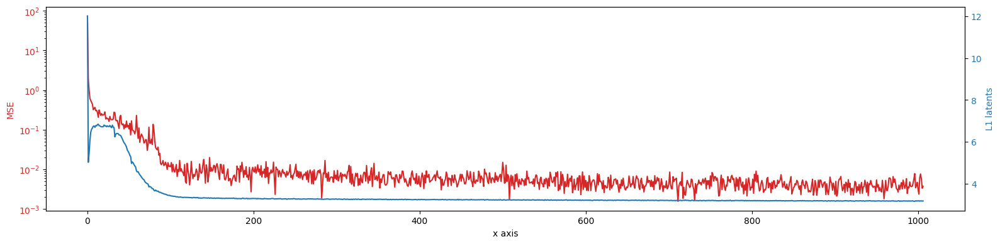

In [21]:
if config.is_train_run:
    rec_loss_list = dict_logs['rec']
    sparse_loss_list = dict_logs['sparse']

    fig, ax1 = plt.subplots(figsize=(16,4))

    color = 'tab:red'
    ax1.set_xlabel('x axis')
    ax1.set_ylabel('MSE', color=color)
    ax1.plot(rec_loss_list, color=color)
    ax1.tick_params(axis='y', labelcolor=color)
    ax1.set_yscale('log')

    ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis

    color = 'tab:blue'
    ax2.set_ylabel('L1 latents', color=color)  # we already handled the x-label with ax1
    ax2.plot(sparse_loss_list, color=color)
    ax2.tick_params(axis='y', labelcolor=color)
    # ax2.set_yscale('log')

    fig.tight_layout()  # otherwise the right y-label is slightly clipped
    plt.show()

In [22]:
filename_model

'sae-x10-n_ep50-bs8192-coef0.01-id02874'

In [23]:
if config.is_train_run:
    # Save model
    torch.save(model.state_dict(), dir_model/(filename_model+"-last"+".ckpt"))

# # Load model
# model.load_state_dict(torch.load(dir_model/ (filename_model+"-last"+".ckpt")))

# Match latent activations and GT masks

In [24]:
# path_data = pathlib.Path("data/clf_features_20_50.safetensors")
# data = safetensors.safe_open(path_data, framework='pt')
# X, y = data.get_tensor('x_50'), data.get_tensor('y')
# print(X.shape, y.shape)
# print(f'Unique vals in y: {y.unique()}')

# path_data = pathlib.Path("diffusion-dict-learn/sae_features_train_1000.safetensors")
path_data = pathlib.Path("diffusion-dict-learn/sae_features_labeled_20_t150.safetensors")
data = safetensors.safe_open(path_data, framework='pt')
X_eval = data.get_tensor('150_6')
# print(X_eval.shape)
# X_eval = X_eval.permute(0,2,3,1)
print(X_eval.shape)

torch.Size([20, 512, 32, 32])


Load masks - y

[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23]


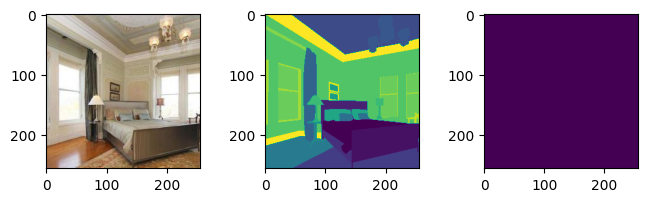

[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 22 25]


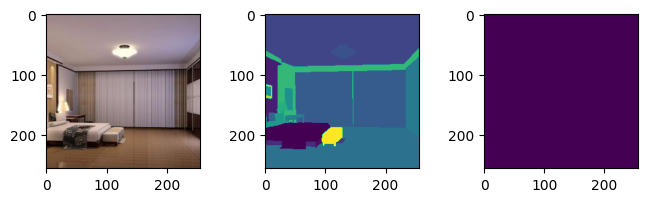

[ 1  2  3  4  6 11 12 13 15 16 17 21 22 24 28]


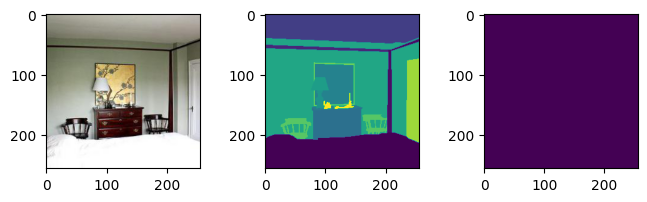

In [25]:
files_img_dataset = 'diffusion-dict-learn/datasets/bedroom_28/real/test'
uniques_filename = list(set([name_.split('.')[0] for name_ in os.listdir(files_img_dataset) if name_.endswith('png')]))

num_iter = 3
i_delta = 0
for filename in uniques_filename[:num_iter]:
    file_mask = pathlib.Path(files_img_dataset) / f"{filename}.npy"
    img_mask = np.load(file_mask)    
    file_png = pathlib.Path(files_img_dataset) / f"{filename}.png"
    img_png = plt.imread(file_png)

    # Unique classes on the mask
    print(np.unique(img_mask))

    f, axs = plt.subplots(1,3, figsize=(8,2))
    axs[0].imshow(img_png)
    axs[1].imshow(img_mask)
    axs[2].imshow(img_mask==0)
    # plt.axes(False)
    plt.show()

In [26]:
y_eval= []
imgs_eval = []
for filename in tqdm(sorted(uniques_filename)):
    file_mask = pathlib.Path(files_img_dataset) / f"{filename}.npy"
    img_mask = np.load(file_mask)    
    file_png = pathlib.Path(files_img_dataset) / f"{filename}.png"
    img_png = plt.imread(file_png)

    y_eval.append(img_mask)
    imgs_eval.append(img_png)

y_eval = np.stack(y_eval)    
imgs_eval = np.stack(imgs_eval)    

print(y_eval.shape, imgs_eval.shape)

  0%|          | 0/20 [00:00<?, ?it/s]

(20, 256, 256) (20, 256, 256, 3)


In [27]:
model.eval()

# Interpolate to the img size, flatten and pass 

latents_list = []
with torch.no_grad():
    for idx, sample in tqdm(enumerate(X_eval), total=len(X_eval), desc="Steps"):
        dense_embs = F.interpolate(
            sample.unsqueeze(0), size=config.image_size, mode='bilinear',
        )[0].permute(1,2,0)
        x_hat, h = model(dense_embs.to(device))
        latents_list.append(h.detach().cpu())

Steps:   0%|          | 0/20 [00:00<?, ?it/s]

In [29]:
def plot_iou_examples(imgs_eval, y_mask, iou, latents_list, rows=5, cols=2+4, ):
    f, axs = plt.subplots(rows, cols, figsize=(2*cols,(1.8*rows)))
    for row_num, sample_ in tqdm(enumerate(imgs_eval[:rows])): 
        # top_neurons_idx = torch.topk(latents_list[0].permute(2,0,1).mean(dim=[1,2]), k=cols-1).indices
        top_neurons_idx = iou.topk(4).indices
        img_png = sample_
        mask_png = y_mask[row_num]
        axs[row_num][0].imshow(img_png)
        axs[row_num][1].imshow(mask_png)
        for col_num, top_neuron_idx_ in enumerate(top_neurons_idx):
            img_latents_mask = latents_list[row_num].permute(2,0,1)[top_neuron_idx_]  
            axs[row_num][col_num+2].imshow(img_latents_mask)
        for ax_ in axs.flatten():
            ax_.set_axis_off()
    plt.tight_layout()
    plt.show()

In [30]:
# Let's overlap with 1 image to start with 
dict_iou = {} # to iterate over images

for idx_img in tqdm(range(len(y_eval)), leave=True):

    # Mask for the classes
    class_labels = np.unique(y_eval[idx_img])

    for class_label_iter in tqdm(class_labels, leave=False):
        if class_label_iter not in dict_iou:
            dict_iou[class_label_iter] = []
            
        y_mask = y_eval==class_label_iter
        # print(f"------Label: {class_label_iter}-----")

        latents_mask = (latents_list[idx_img].permute(2,0,1)) #>0
        intersection = (latents_mask * y_mask[idx_img]).sum(dim=[1,2])
        sum_y_mask = y_mask[idx_img].sum()
        sum_latents_mask = latents_mask.sum(dim=[1,2])

        union = sum_latents_mask + sum_y_mask
        # iwm = intersection / sum_y_mask
        iou = intersection / union
        
        dict_iou[class_label_iter].append(iou)
        
        # print(f"Intersection with mask\n{iwm.topk(10)}")
        # print(f"IoU\n{iou.topk(10)}")

        # plot_iou_examples(imgs_eval, y_mask, iou, latents_list, rows=5, cols=2+4, )

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/12 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

  0%|          | 0/17 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/13 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/22 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/12 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/12 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/23 [00:00<?, ?it/s]

------Label: 0-----
IoU
torch.return_types.topk(
values=tensor([0.1316, 0.1303, 0.0846, 0.0834, 0.0793, 0.0772, 0.0767, 0.0728, 0.0718,
        0.0696]),
indices=tensor([3801, 4834, 2132, 5045, 4403, 2840,  187, 4642, 4402, 3592]))


0it [00:00, ?it/s]

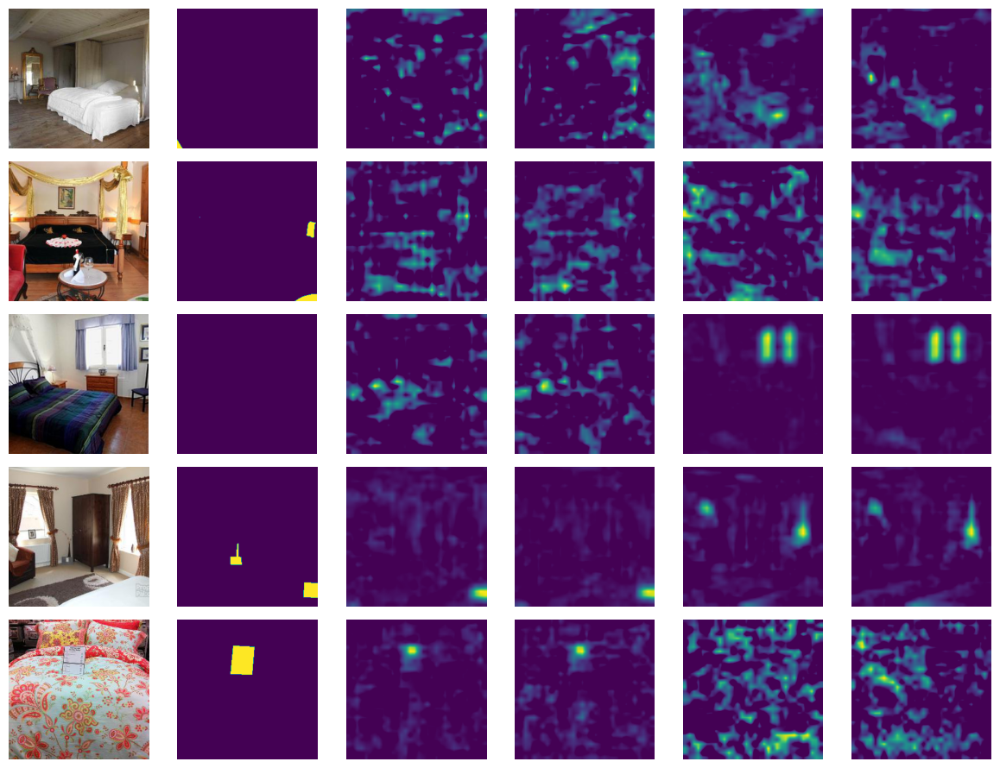

------Label: 1-----
IoU
torch.return_types.topk(
values=tensor([0.5742, 0.5258, 0.4987, 0.4249, 0.3687, 0.3578, 0.3304, 0.3298, 0.3204,
        0.3012]),
indices=tensor([4080, 1388, 4887, 3515,  493, 4602, 3121, 2208, 2527, 1285]))


0it [00:00, ?it/s]

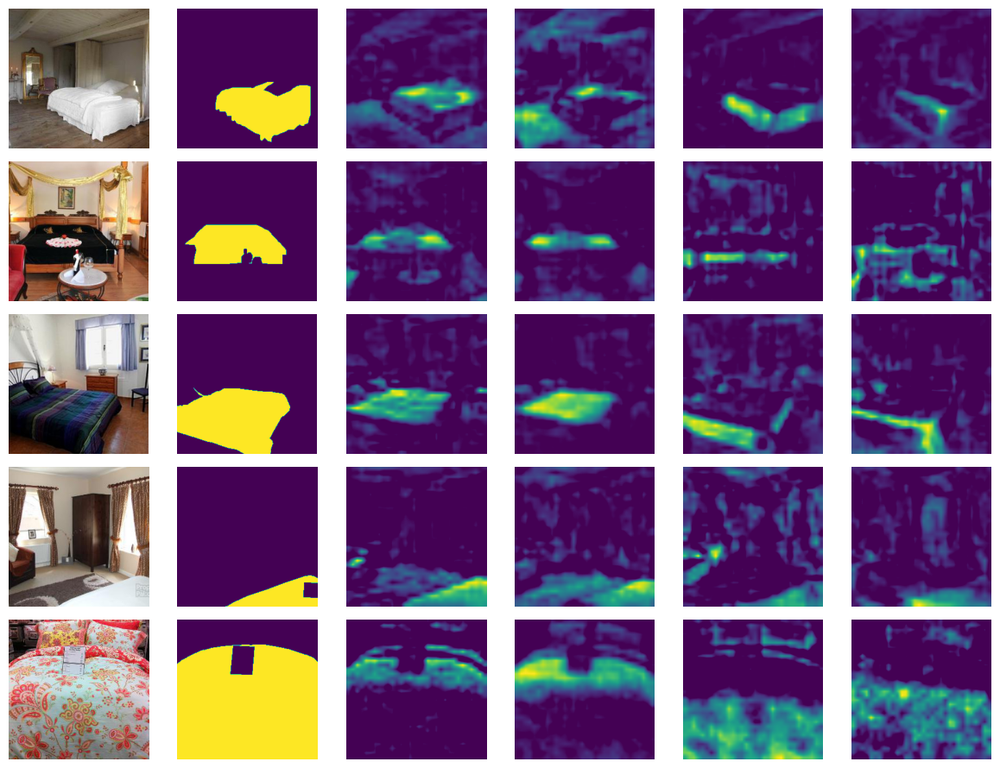

------Label: 6-----
IoU
torch.return_types.topk(
values=tensor([0.5798, 0.5690, 0.3342, 0.2727, 0.2507, 0.2466, 0.2160, 0.1999, 0.1969,
        0.1952]),
indices=tensor([2479, 2912, 3962, 1365,   84, 4821, 3300, 4756, 2970, 1572]))


0it [00:00, ?it/s]

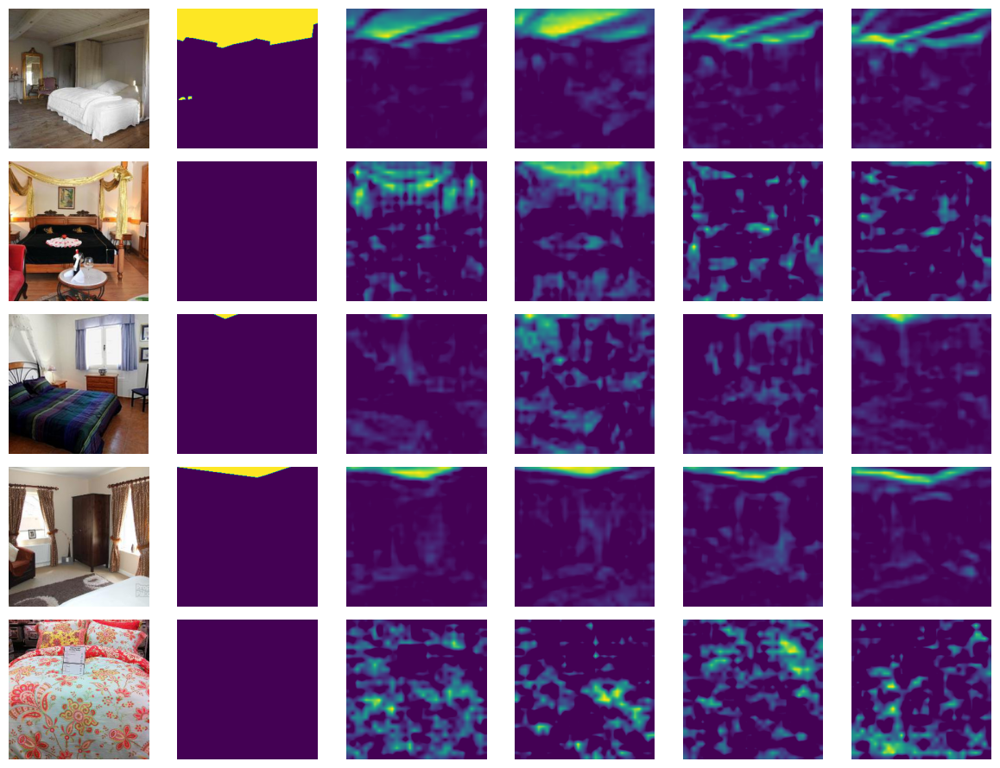

------Label: 10-----
IoU
torch.return_types.topk(
values=tensor([0.4516, 0.4300, 0.3559, 0.3127, 0.2723, 0.2651, 0.2353, 0.2303, 0.2230,
        0.1993]),
indices=tensor([4403, 4642, 2617, 1653, 4997, 1339, 2331, 4127, 2001, 2650]))


0it [00:00, ?it/s]

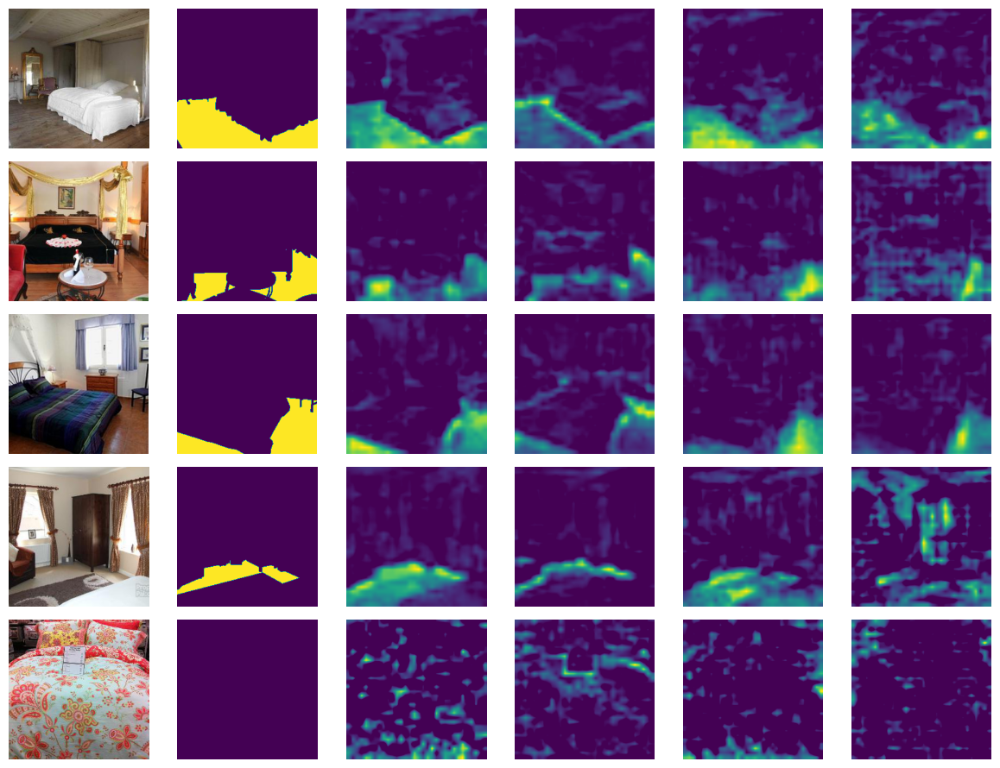

------Label: 11-----
IoU
torch.return_types.topk(
values=tensor([0.1366, 0.1365, 0.1355, 0.1237, 0.1185, 0.0932, 0.0856, 0.0802, 0.0791,
        0.0766]),
indices=tensor([1015,  187, 2583, 1339, 4249, 4971,   72, 3752, 4572, 4289]))


0it [00:00, ?it/s]

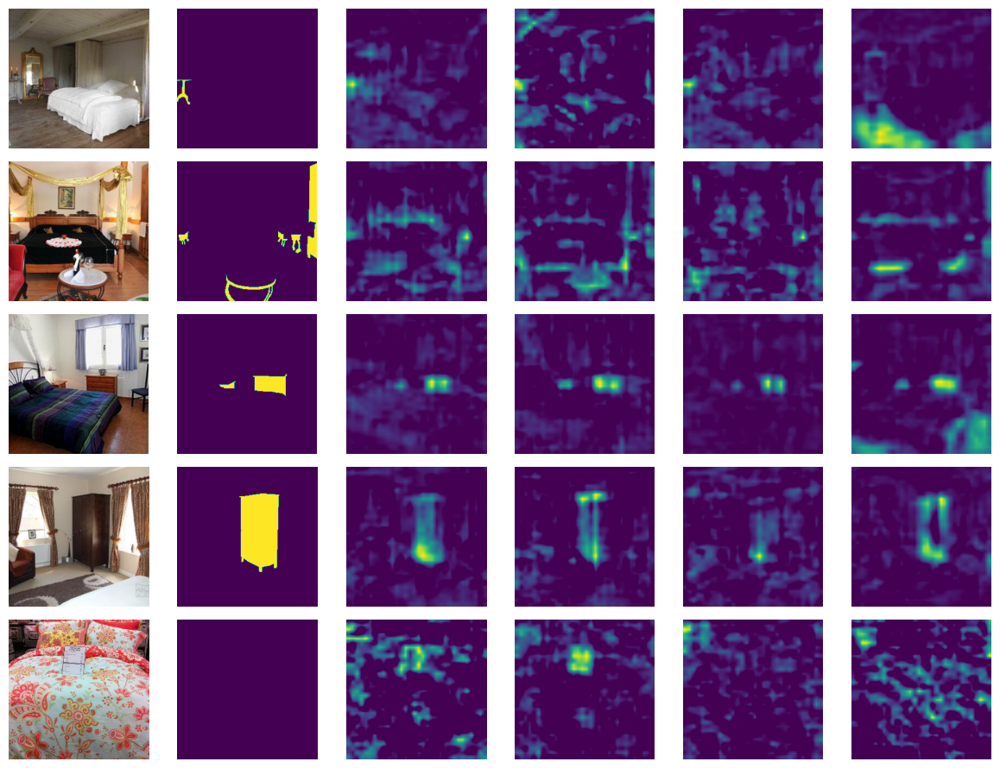

------Label: 12-----
IoU
torch.return_types.topk(
values=tensor([0.0871, 0.0702, 0.0447, 0.0278, 0.0276, 0.0263, 0.0246, 0.0238, 0.0226,
        0.0194]),
indices=tensor([ 848, 2697, 4289, 4016, 4177,  986,  187,  507, 4642, 3063]))


0it [00:00, ?it/s]

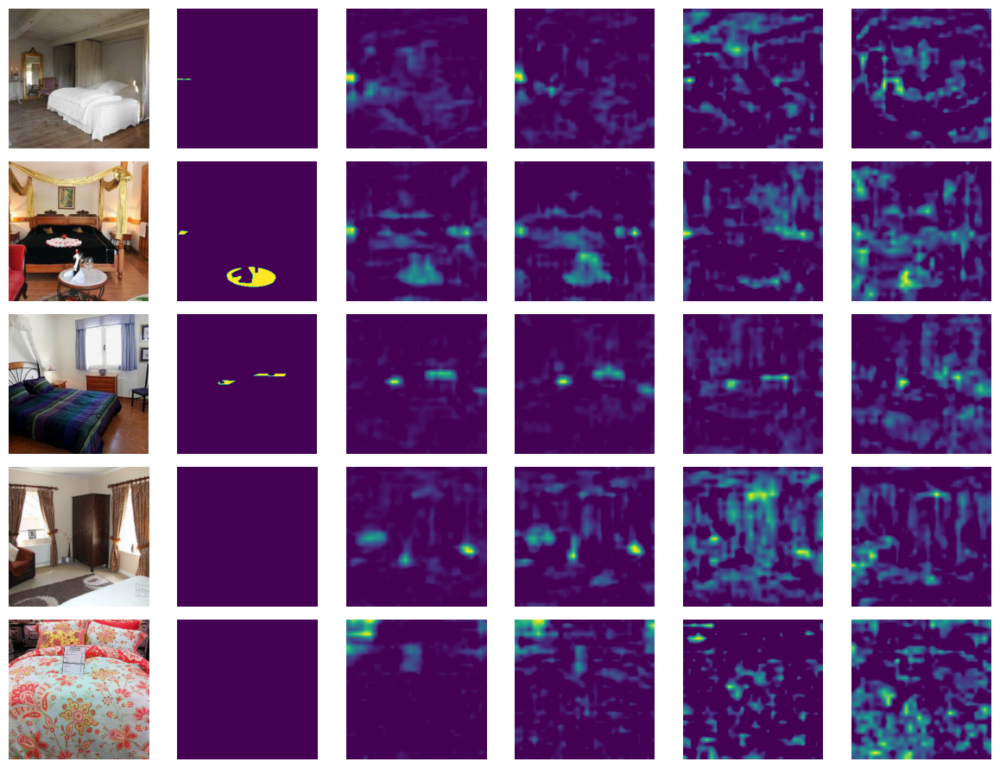

------Label: 13-----
IoU
torch.return_types.topk(
values=tensor([0.1550, 0.1347, 0.1322, 0.1169, 0.1104, 0.0881, 0.0767, 0.0681, 0.0673,
        0.0619]),
indices=tensor([ 218, 1135, 2935, 1723, 2429, 2368, 4430, 4058, 2026, 2335]))


0it [00:00, ?it/s]

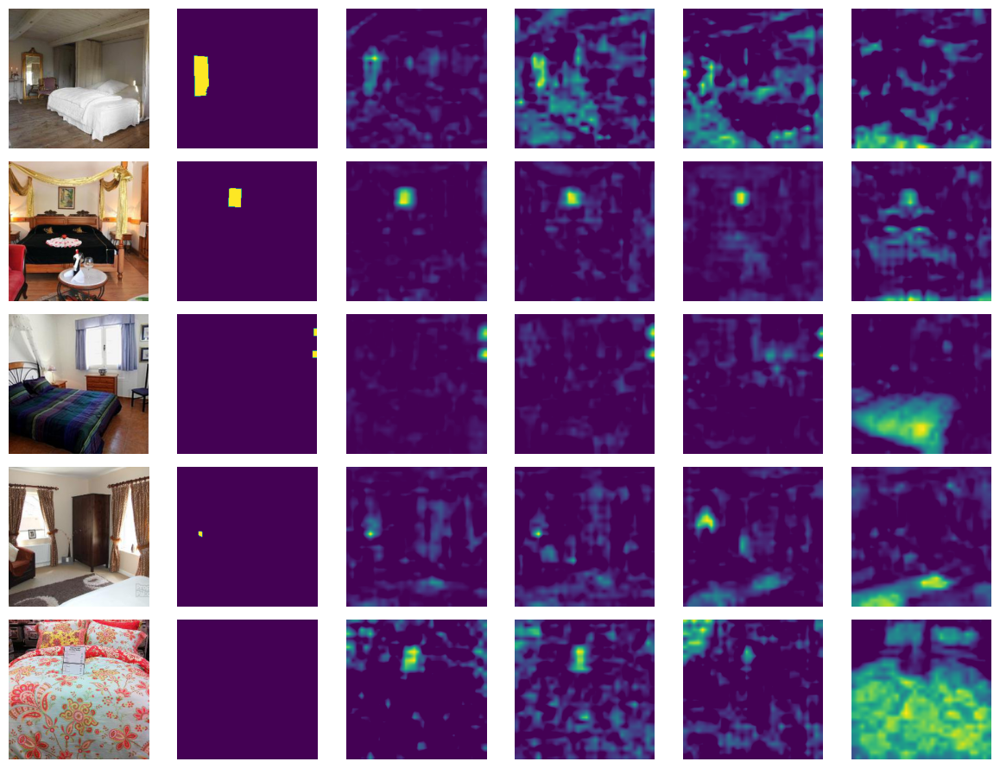

------Label: 14-----
IoU
torch.return_types.topk(
values=tensor([0.2535, 0.2352, 0.2204, 0.1846, 0.1517, 0.1511, 0.1384, 0.1288, 0.1286,
        0.1272]),
indices=tensor([3660, 2832,  575, 5098, 4672, 4983, 3532, 4164, 1288,  837]))


0it [00:00, ?it/s]

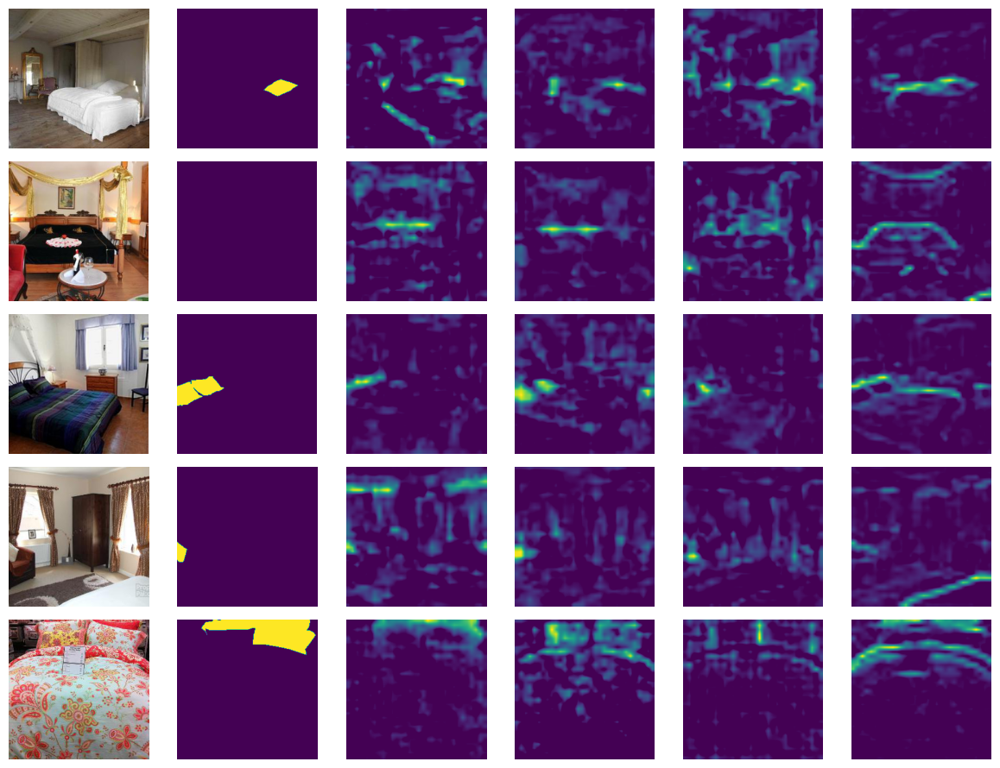

------Label: 17-----
IoU
torch.return_types.topk(
values=tensor([0.6624, 0.5333, 0.5187, 0.4731, 0.4396, 0.4204, 0.4170, 0.4003, 0.3956,
        0.3709]),
indices=tensor([ 200,  336, 4756, 2730, 4224, 2944, 3300,  397,  354, 4750]))


0it [00:00, ?it/s]

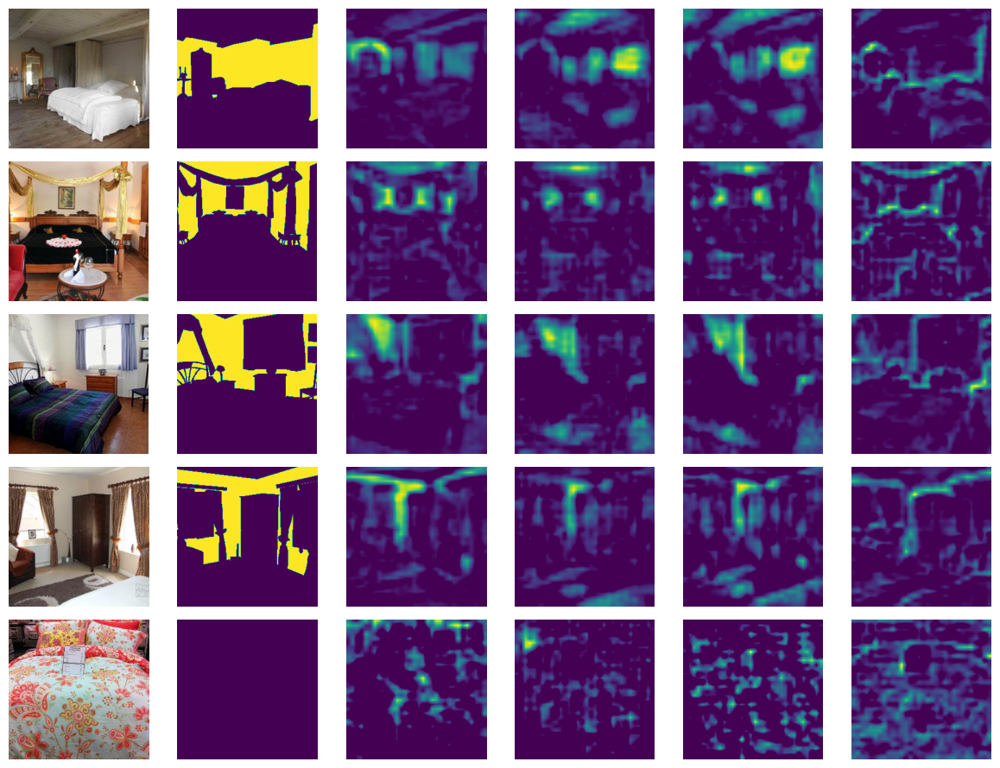

------Label: 21-----
IoU
torch.return_types.topk(
values=tensor([0.0987, 0.0895, 0.0880, 0.0837, 0.0795, 0.0774, 0.0718, 0.0691, 0.0681,
        0.0671]),
indices=tensor([4016, 4971,  284, 2832, 3035, 1261,  936, 1774, 2087, 1563]))


0it [00:00, ?it/s]

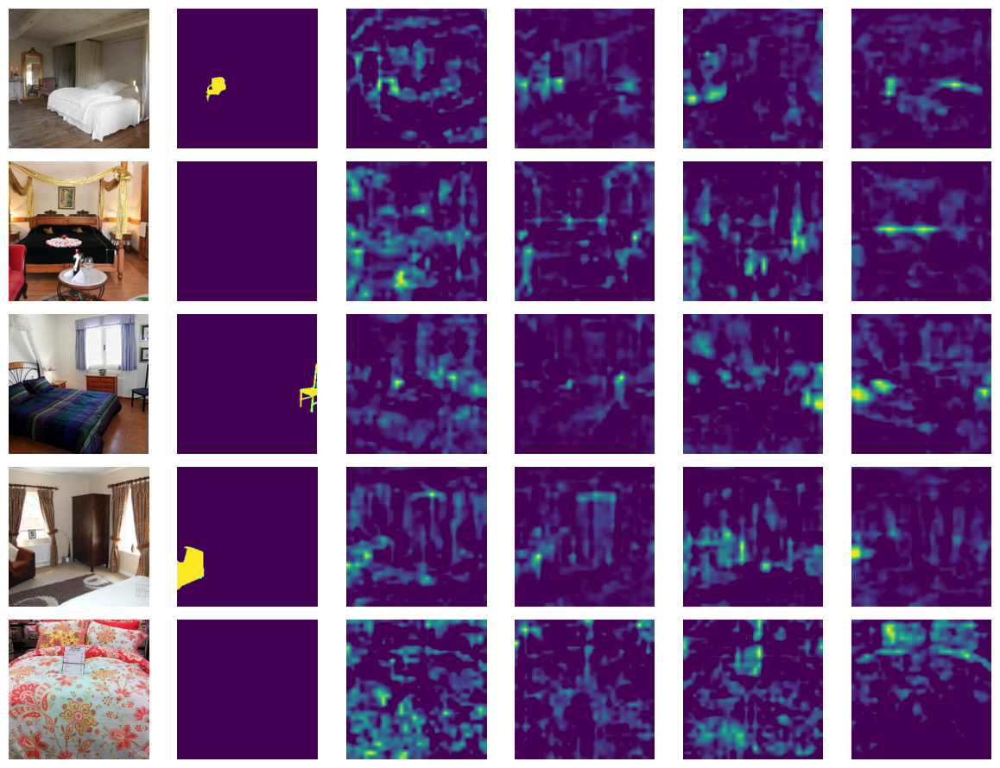

------Label: 22-----
IoU
torch.return_types.topk(
values=tensor([0.0746, 0.0685, 0.0644, 0.0482, 0.0393, 0.0370, 0.0363, 0.0348, 0.0319,
        0.0301]),
indices=tensor([2429,  218, 4058, 1135,   72, 4371, 1964,  364, 3507,   82]))


0it [00:00, ?it/s]

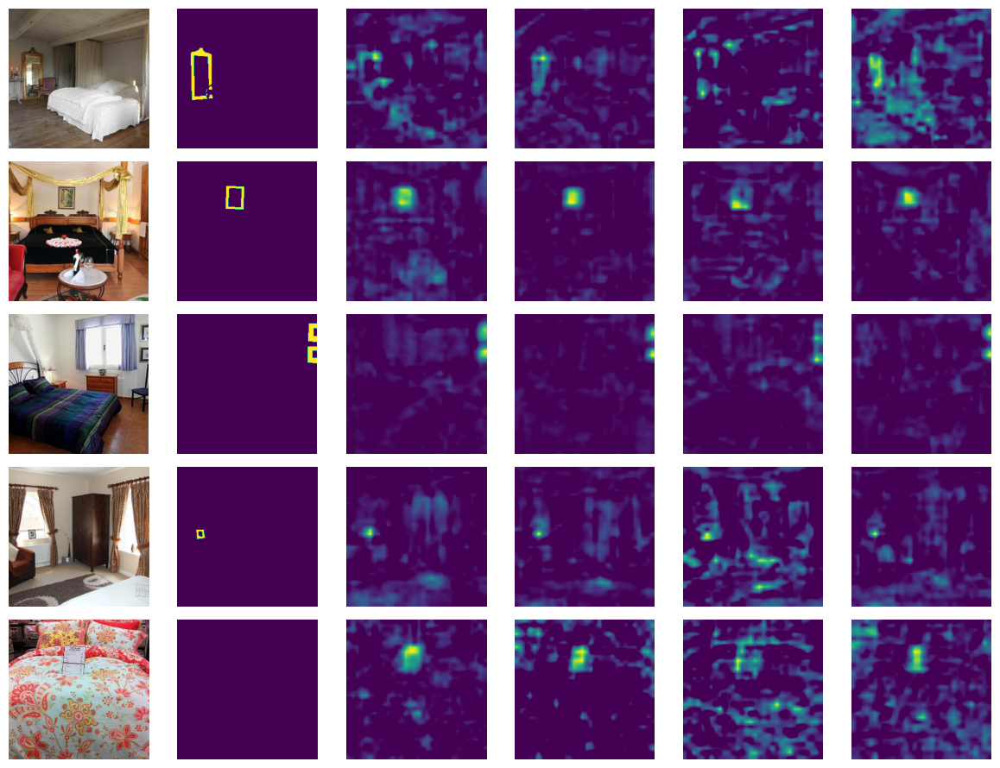

------Label: 28-----
IoU
torch.return_types.topk(
values=tensor([0.0778, 0.0674, 0.0641, 0.0390, 0.0341, 0.0308, 0.0279, 0.0247, 0.0247,
        0.0241]),
indices=tensor([ 848, 4772, 2697,  986, 4274, 3936, 3485, 3814, 1774, 2549]))


0it [00:00, ?it/s]

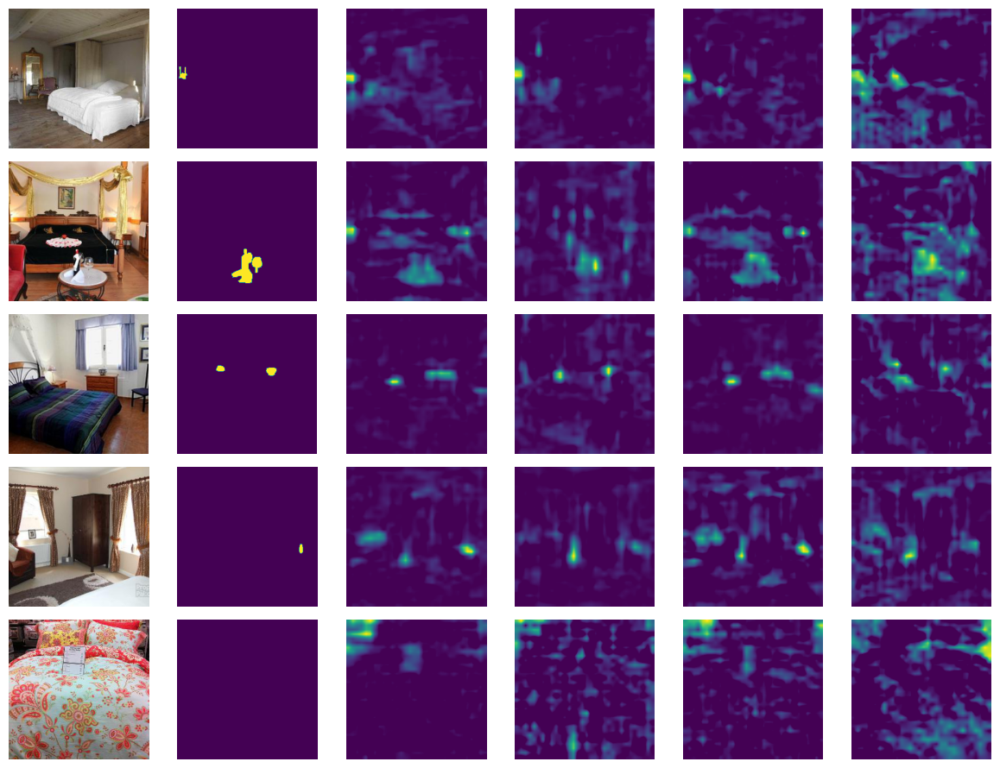

------Label: 2-----
IoU
torch.return_types.topk(
values=tensor([0.1447, 0.1036, 0.1022, 0.0961, 0.0877, 0.0868, 0.0855, 0.0849, 0.0817,
        0.0813]),
indices=tensor([3366, 4904,  187, 1339, 3114, 3743,  360,    3, 1261, 3680]))


0it [00:00, ?it/s]

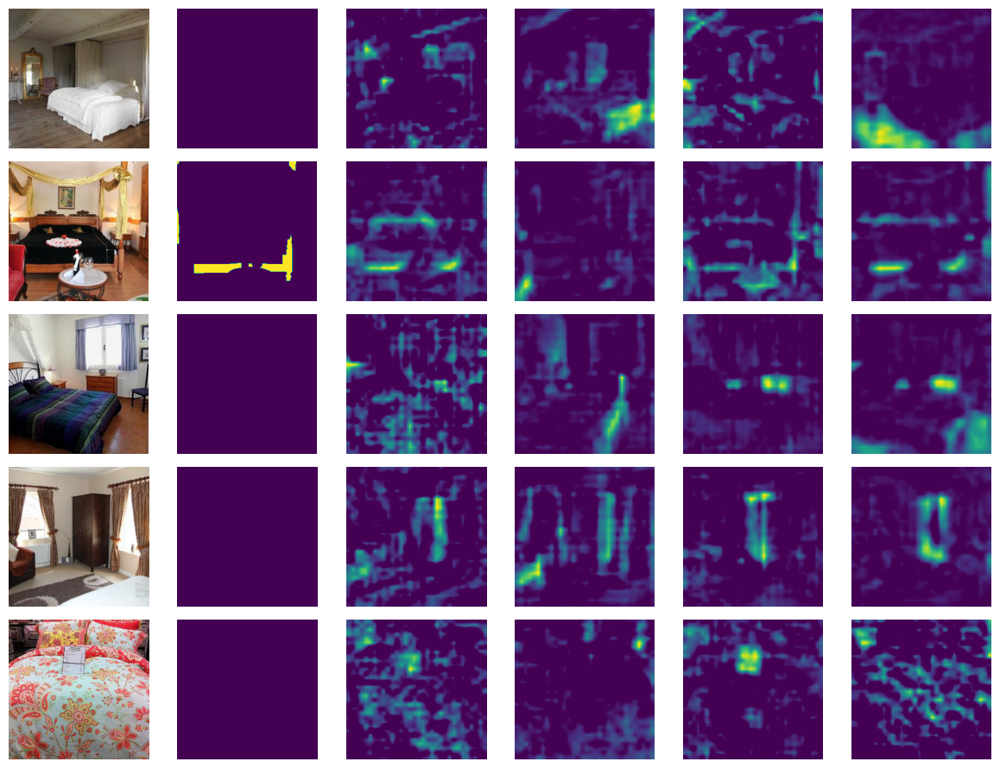

------Label: 3-----
IoU
torch.return_types.topk(
values=tensor([0.1951, 0.1715, 0.1548, 0.1455, 0.1398, 0.1310, 0.1261, 0.1116, 0.1110,
        0.1109]),
indices=tensor([3366,  936, 3660, 2934,  222, 4679,  575,  612, 1034, 4660]))


0it [00:00, ?it/s]

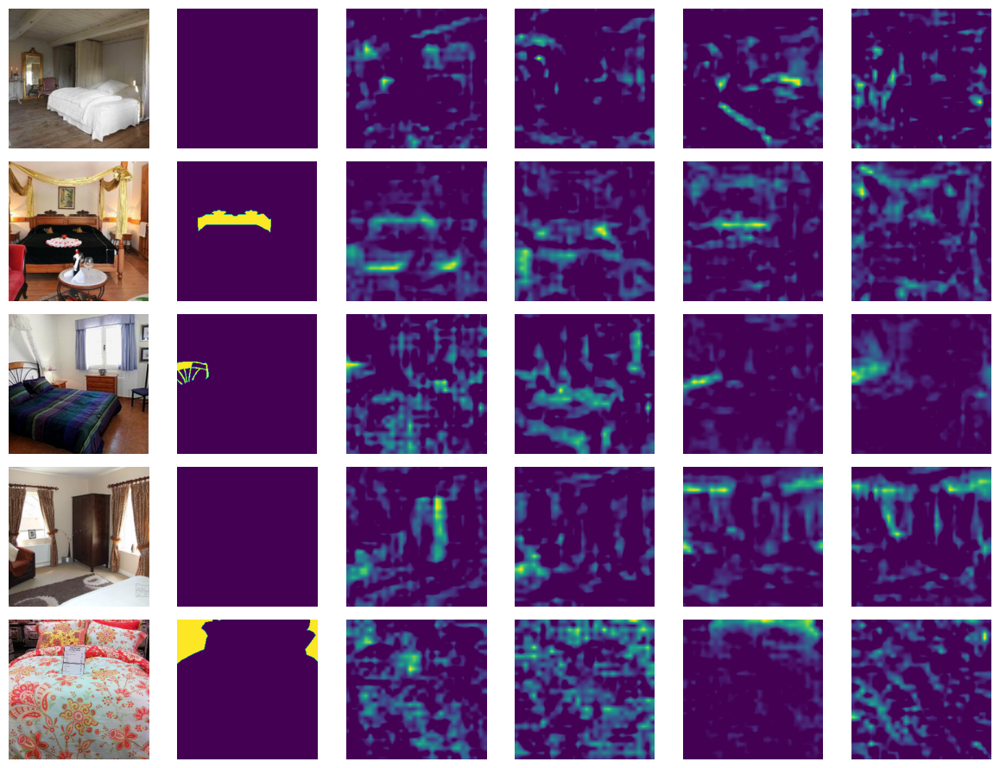

------Label: 5-----
IoU
torch.return_types.topk(
values=tensor([0.3012, 0.1942, 0.1444, 0.1271, 0.1263, 0.1183, 0.1129, 0.1113, 0.1044,
        0.1025]),
indices=tensor([4403, 2617, 1723, 4642, 2331, 4997,   47, 4450, 2548,  378]))


0it [00:00, ?it/s]

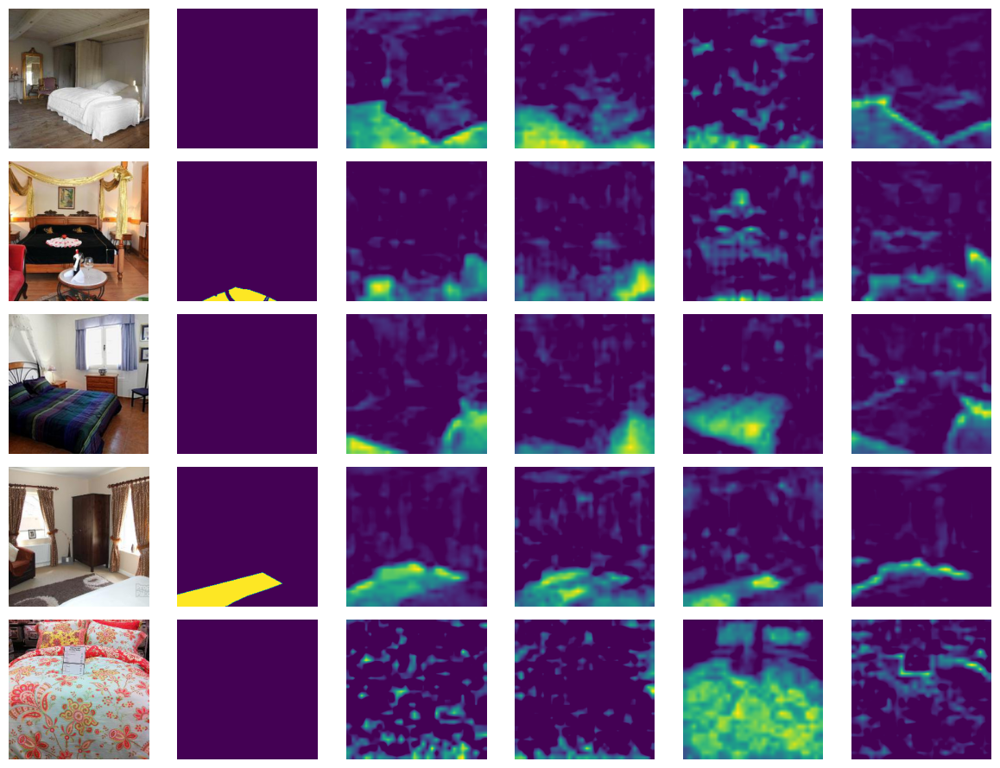

------Label: 8-----
IoU
torch.return_types.topk(
values=tensor([0.5408, 0.3354, 0.2572, 0.2157, 0.1809, 0.1780, 0.1733, 0.1645, 0.1643,
        0.1625]),
indices=tensor([1617, 4690, 2866,  296,   72, 4443, 4314,  627, 2340, 1333]))


0it [00:00, ?it/s]

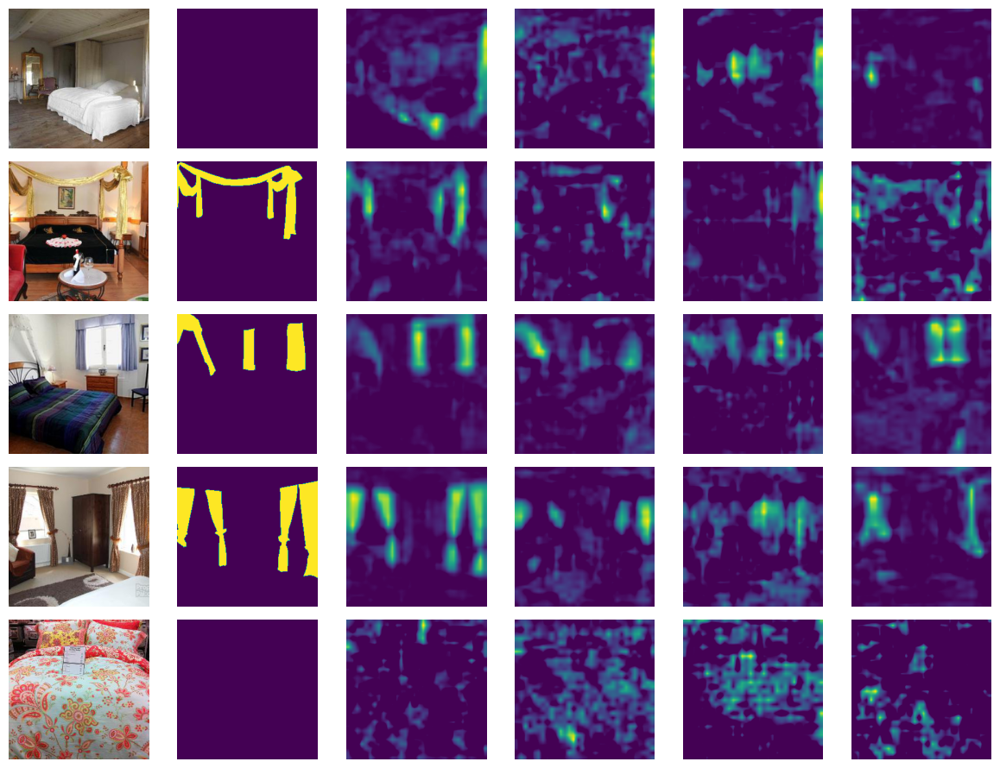

------Label: 23-----
IoU
torch.return_types.topk(
values=tensor([0.1205, 0.0866, 0.0672, 0.0651, 0.0600, 0.0565, 0.0525, 0.0519, 0.0512,
        0.0508]),
indices=tensor([1365, 3962, 2479, 3184, 3652, 2704,   22, 2842, 2912, 3731]))


0it [00:00, ?it/s]

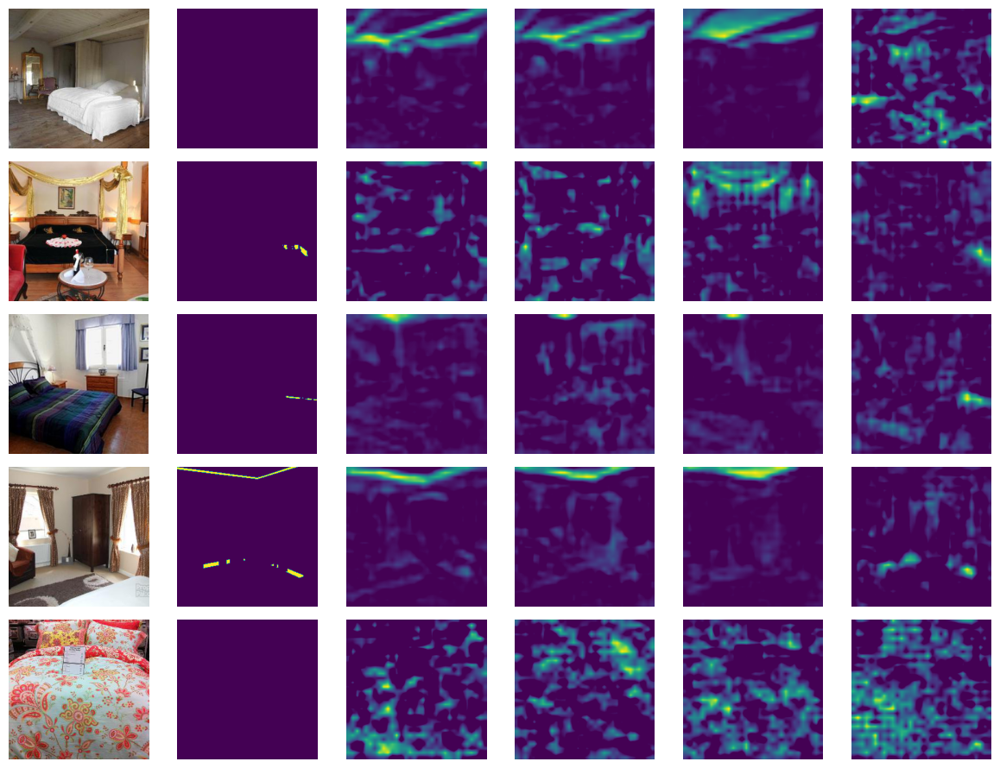

------Label: 25-----
IoU
torch.return_types.topk(
values=tensor([0.1532, 0.1421, 0.1392, 0.1386, 0.1281, 0.1263, 0.1262, 0.1256, 0.1249,
        0.1218]),
indices=tensor([4904, 2459, 3121,  493, 1817, 1649, 4016,  187, 2208, 4752]))


0it [00:00, ?it/s]

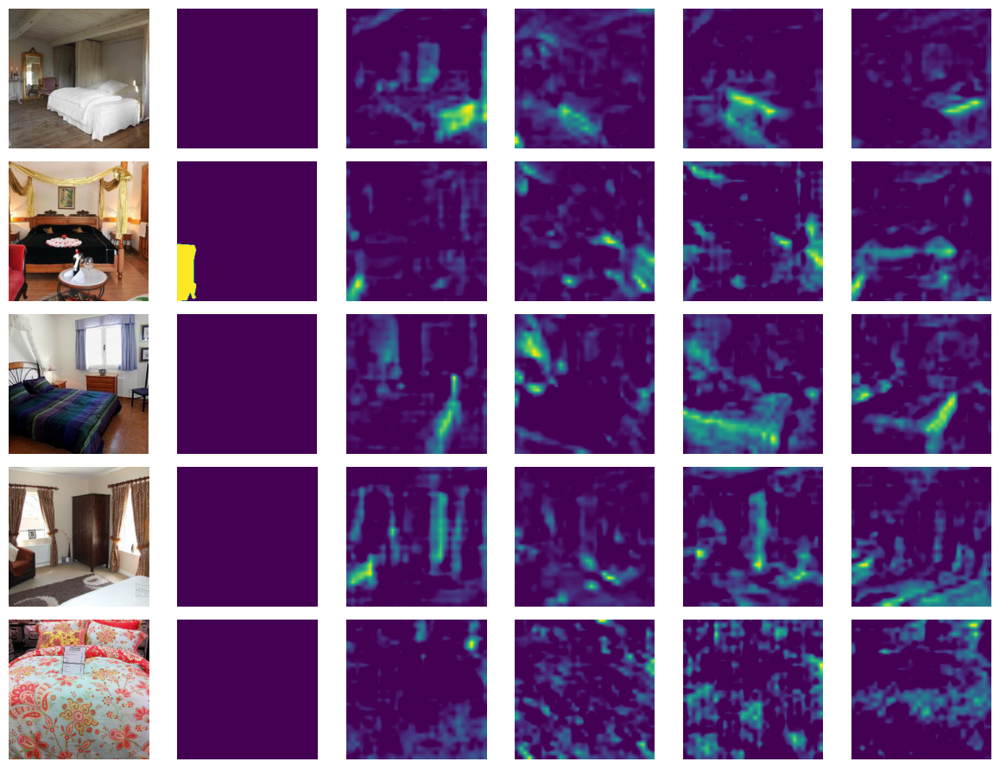

------Label: 15-----
IoU
torch.return_types.topk(
values=tensor([0.0319, 0.0259, 0.0240, 0.0199, 0.0157, 0.0152, 0.0145, 0.0137, 0.0136,
        0.0130]),
indices=tensor([4772,  848, 2697, 2549, 4274, 3219,  986, 3485, 4112,  284]))


0it [00:00, ?it/s]

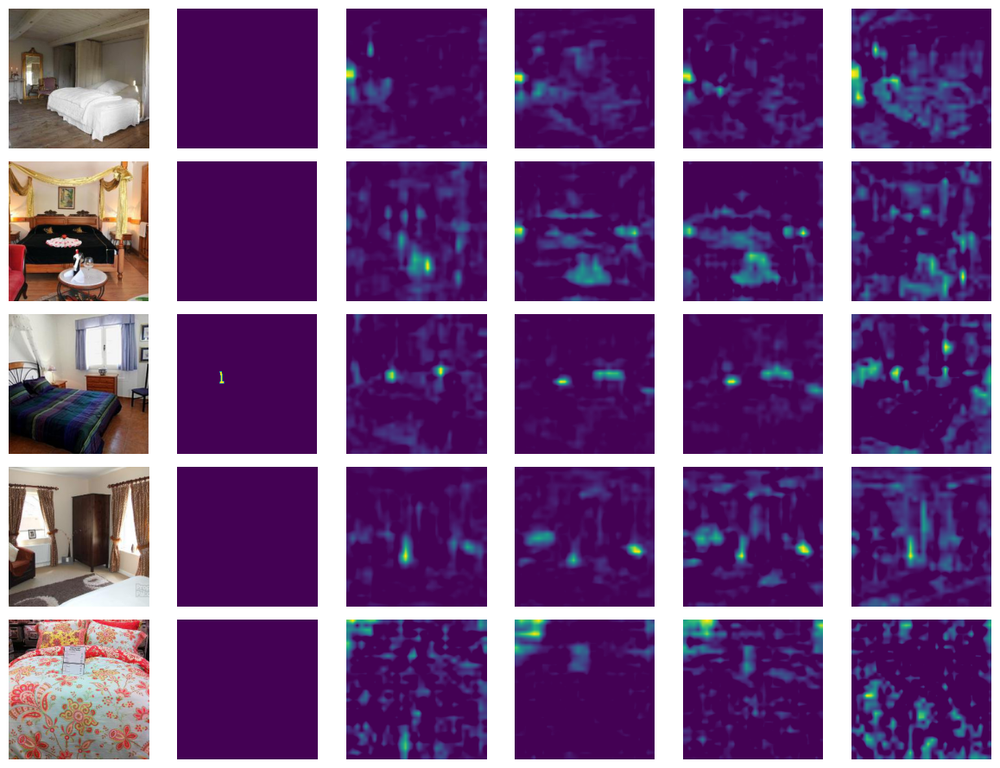

------Label: 18-----
IoU
torch.return_types.topk(
values=tensor([0.4269, 0.3499, 0.2689, 0.2601, 0.2179, 0.1594, 0.1195, 0.1078, 0.1063,
        0.1057]),
indices=tensor([ 137,  296, 2935, 3329, 5045, 2132, 2866,  303,   72,  429]))


0it [00:00, ?it/s]

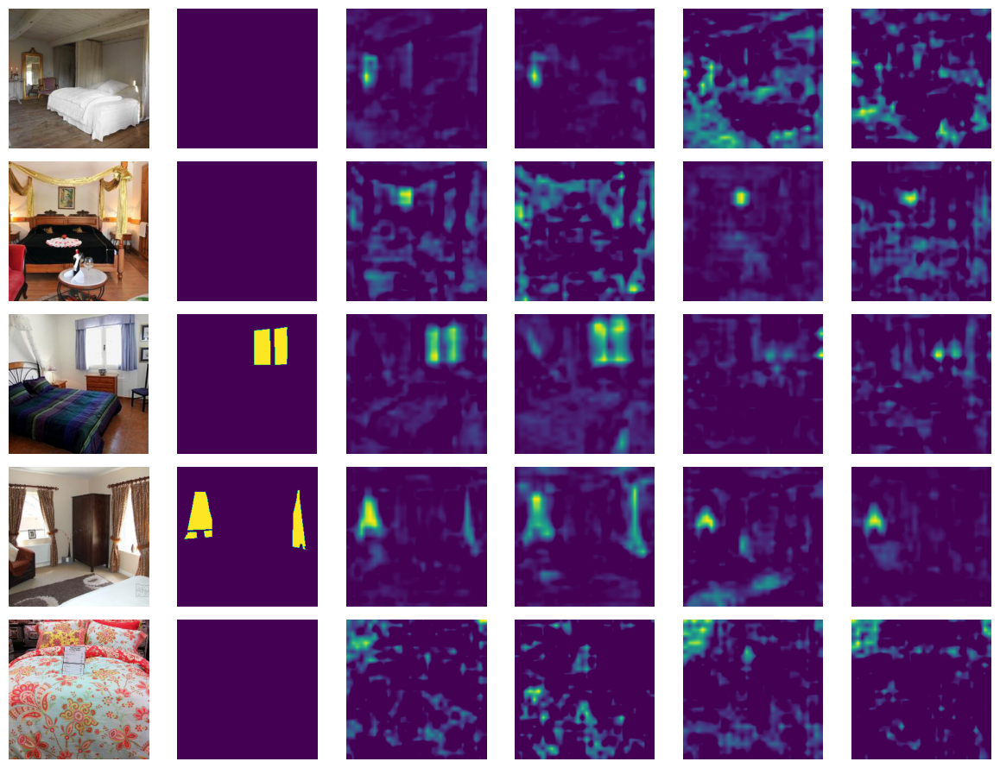

------Label: 19-----
IoU
torch.return_types.topk(
values=tensor([0.0756, 0.0711, 0.0629, 0.0556, 0.0541, 0.0499, 0.0487, 0.0466, 0.0454,
        0.0454]),
indices=tensor([ 721, 1541, 4109, 2348, 4314, 1376,  112, 1760, 4679,  780]))


0it [00:00, ?it/s]

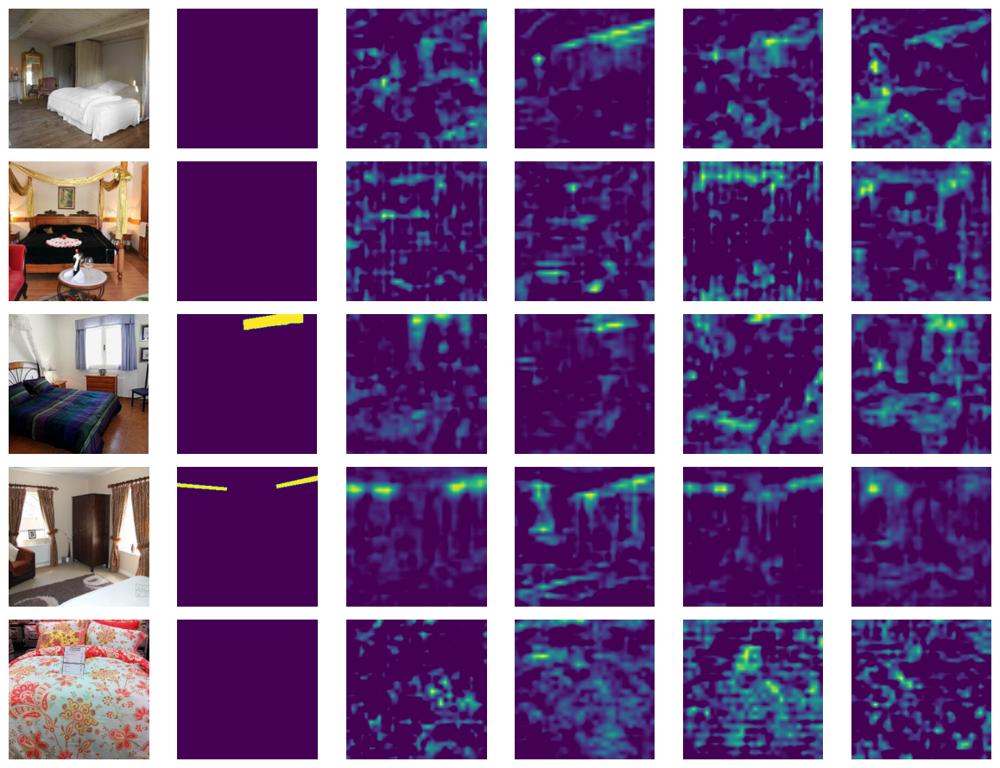

------Label: 20-----
IoU
torch.return_types.topk(
values=tensor([0.0775, 0.0647, 0.0585, 0.0575, 0.0505, 0.0470, 0.0443, 0.0434, 0.0413,
        0.0406]),
indices=tensor([  72,  296, 2818, 2866,  137, 4679,   82,  528, 1523, 1760]))


0it [00:00, ?it/s]

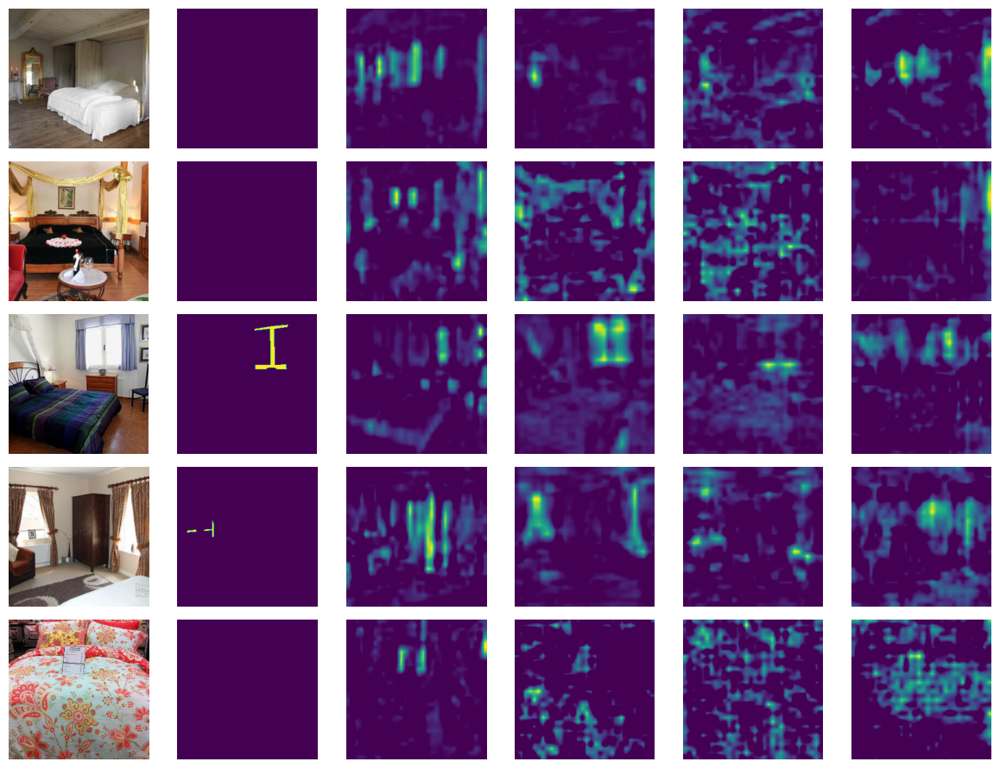

------Label: 9-----
IoU
torch.return_types.topk(
values=tensor([0.2085, 0.1701, 0.1131, 0.0978, 0.0966, 0.0948, 0.0926, 0.0916, 0.0889,
        0.0822]),
indices=tensor([2832, 1774, 4983, 2429,  575,  212, 4339, 1723, 1485, 3660]))


0it [00:00, ?it/s]

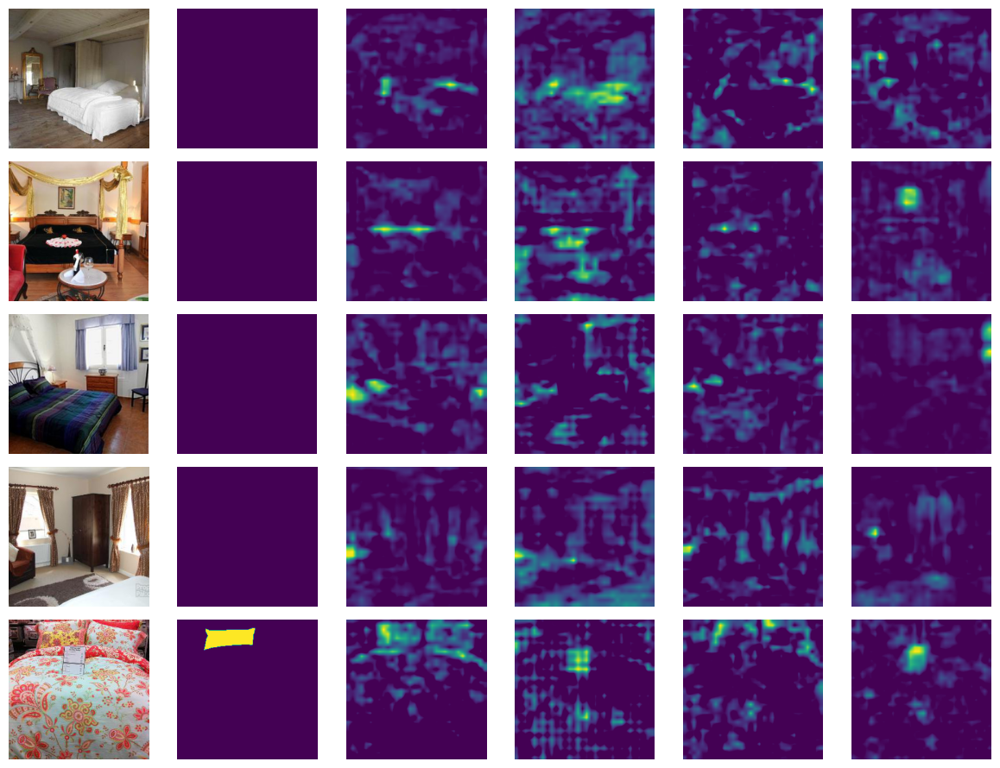

------Label: 16-----
IoU
torch.return_types.topk(
values=tensor([0.1470, 0.1225, 0.0832, 0.0822, 0.0531, 0.0416, 0.0403, 0.0395, 0.0381,
        0.0359]),
indices=tensor([3936, 4274, 4638,  522, 1926, 3219, 4772, 1377, 1283, 1544]))


0it [00:00, ?it/s]

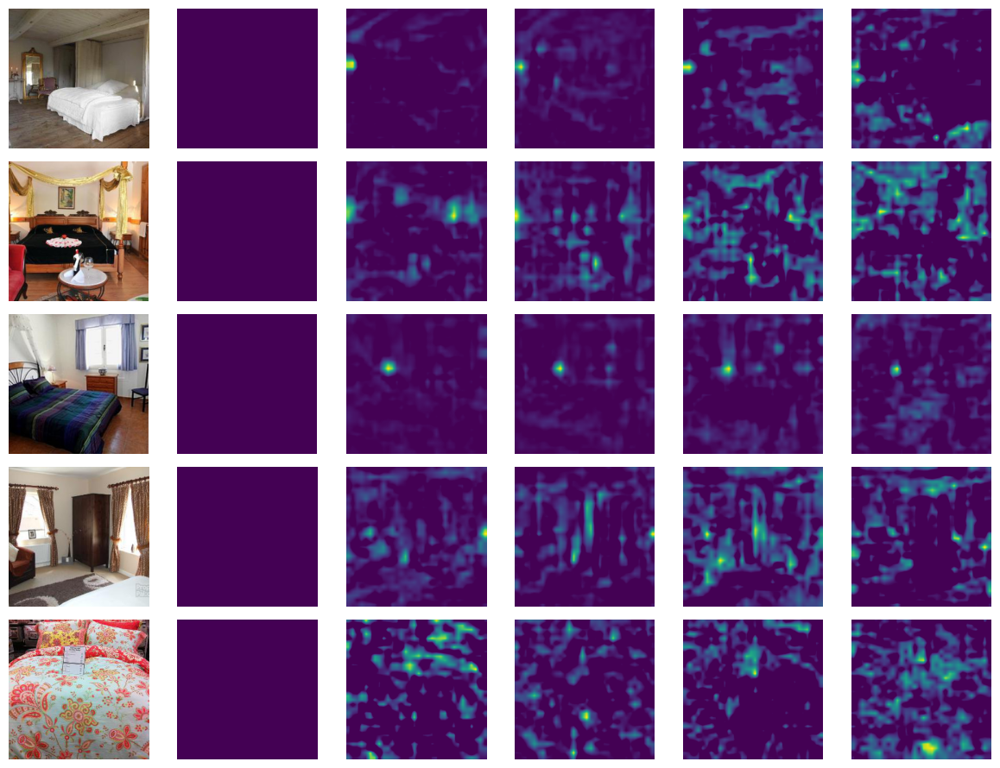

------Label: 4-----
IoU
torch.return_types.topk(
values=tensor([0.0669, 0.0595, 0.0587, 0.0561, 0.0534, 0.0514, 0.0491, 0.0473, 0.0467,
        0.0465]),
indices=tensor([2459, 2331,  450, 3256,  342, 2801,  860,  139, 2232, 3084]))


0it [00:00, ?it/s]

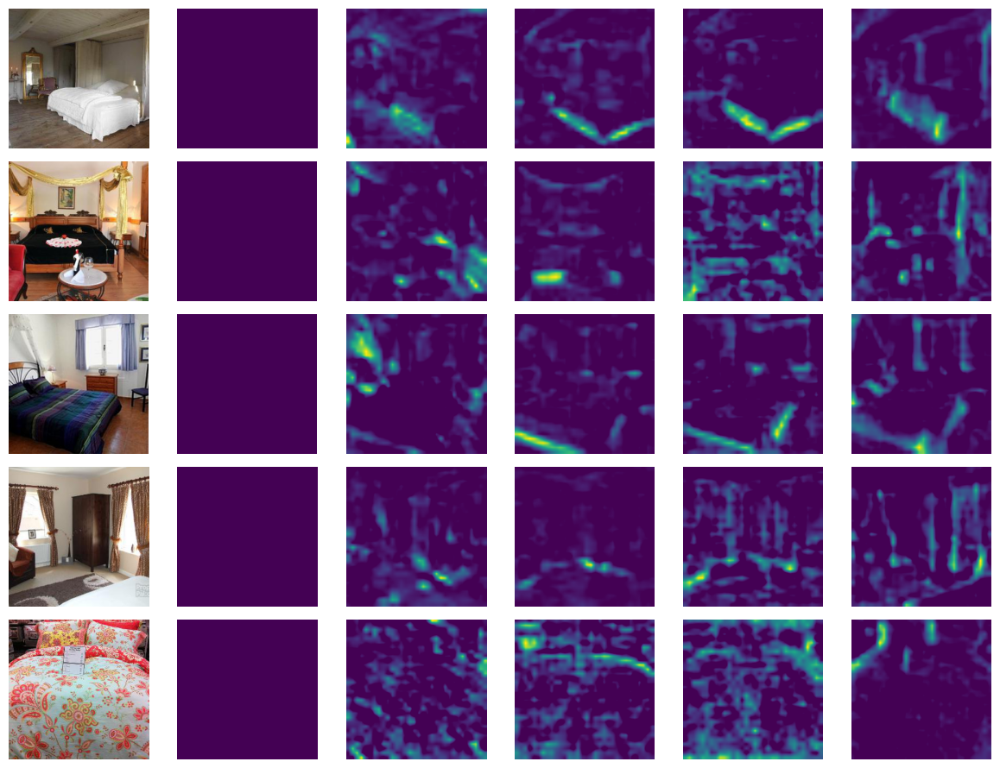

------Label: 7-----
IoU
torch.return_types.topk(
values=tensor([0.1173, 0.1148, 0.0970, 0.0955, 0.0894, 0.0865, 0.0857, 0.0843, 0.0768,
        0.0762]),
indices=tensor([3668, 1152, 1803, 4274, 3211, 2549, 1258, 3737, 1671, 4051]))


0it [00:00, ?it/s]

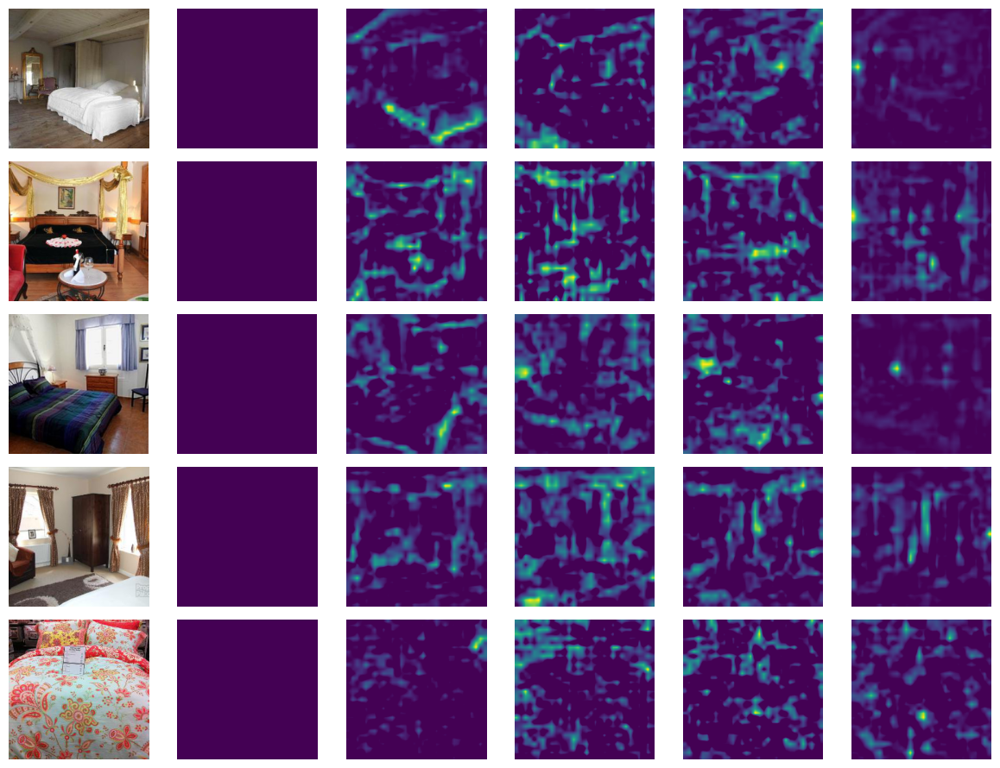

------Label: 27-----
IoU
torch.return_types.topk(
values=tensor([0.1955, 0.1703, 0.1664, 0.1649, 0.1505, 0.1306, 0.1155, 0.1140, 0.1018,
        0.1016]),
indices=tensor([2935, 3693, 3526, 1648, 3329,  708, 4016, 4772, 2697, 3814]))


0it [00:00, ?it/s]

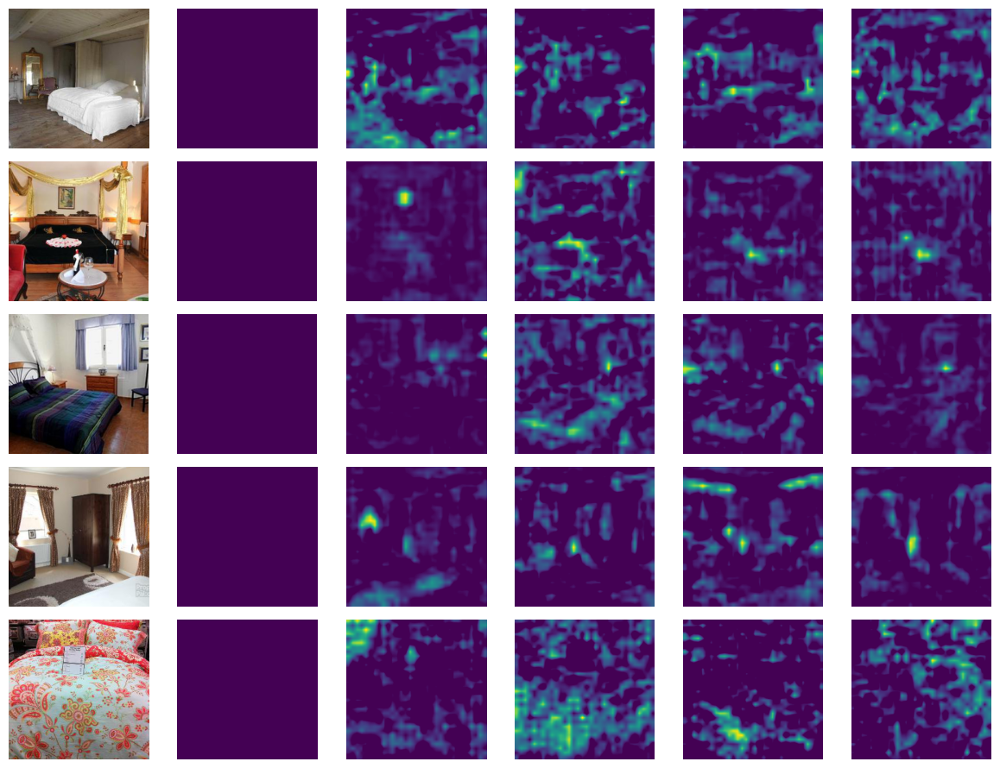

------Label: 26-----
IoU
torch.return_types.topk(
values=tensor([0.2953, 0.2471, 0.2102, 0.1985, 0.1901, 0.1856, 0.1814, 0.1813, 0.1811,
        0.1800]),
indices=tensor([ 429,  296, 2890, 5008, 1760, 3553,  137, 4878, 3990,  767]))


0it [00:00, ?it/s]

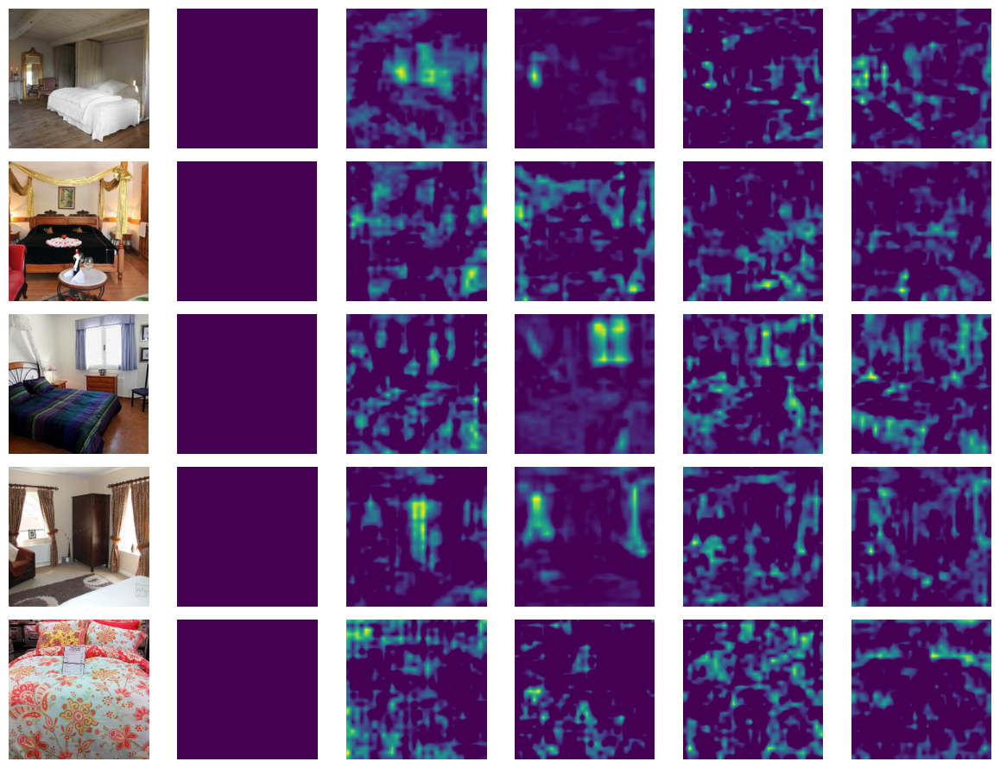

------Label: 24-----
IoU
torch.return_types.topk(
values=tensor([0.4059, 0.3836, 0.3338, 0.3249, 0.2995, 0.2821, 0.2620, 0.2362, 0.2312,
        0.2294]),
indices=tensor([3752,   72, 2866,  119, 1518, 4224, 1111, 4489, 4072, 4668]))


0it [00:00, ?it/s]

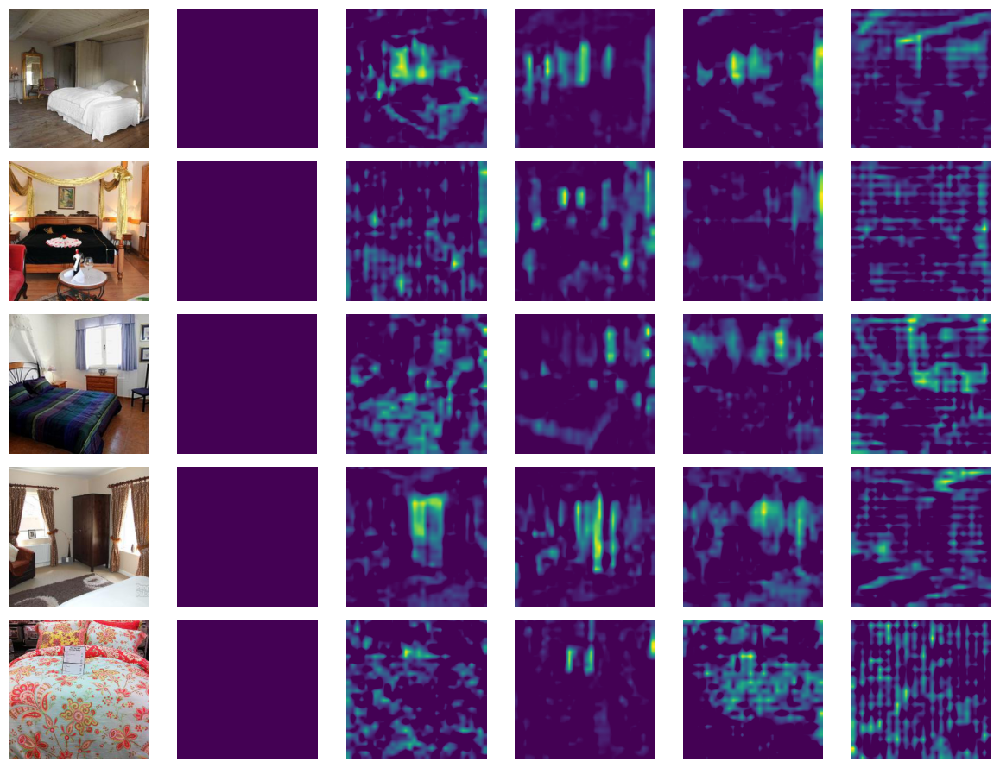

In [31]:
for label in dict_iou.keys():
    y_mask = y_eval==label
    print(f"------Label: {label}-----")
    iou_stacked_avg = torch.vstack(dict_iou[label]).mean(0)
    print(f"IoU\n{iou_stacked_avg.topk(10)}")
    plot_iou_examples(imgs_eval, y_mask, iou_stacked_avg, latents_list, rows=5, cols=2+4, )    